In [1]:
## Import Packages
from __future__ import print_function

import numpy as np
import pandas as pd
from itertools import product

#Astro Software
import astropy.units as units
from astropy.coordinates import SkyCoord
from astropy.io import fits

#Plotting Packages
import matplotlib as mpl
import matplotlib.cm as cmplt
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.colors import LogNorm
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable

import seaborn as sns

from PIL import Image, ImageDraw

from yt.config import ytcfg
import yt
from yt.analysis_modules.ppv_cube.api import PPVCube
import yt.units as u

#Scattering NN
import torch
import torch.nn.functional as F
from torch import optim
from kymatio.torch import Scattering2D
device = "cpu"

#Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.mixture import GaussianMixture
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.decomposition import PCA, FastICA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

import skimage
from skimage import filters
from skimage.filters import window

from scipy.optimize import curve_fit
from scipy import linalg
from scipy import stats
from scipy.signal import general_gaussian
from scipy.ndimage import map_coordinates

# from scipy.sparse import csr_matrix
from scipy.sparse import csc_matrix
from scipy.sparse.csgraph import reverse_cuthill_mckee

#I/O
import h5py
import pickle
import glob
import copy
import time
import os
#from bs4 import BeautifulSoup
import scipy.io as sio

#Plotting Style
%matplotlib inline
plt.style.use('dark_background')
rcParams['text.usetex'] = False
rcParams['axes.titlesize'] = 20
rcParams['xtick.labelsize'] = 16
rcParams['ytick.labelsize'] = 16
rcParams['legend.fontsize'] = 12
rcParams['axes.labelsize'] = 20
rcParams['font.family'] = 'sans-serif'

#Threading
torch.set_num_threads=2
from multiprocessing import Pool

import ntpath
def path_leaf(path):
    head, tail = ntpath.split(path)
    out = os.path.splitext(tail)[0]
    return out

def hd5_open(file_name,name):
    f=h5py.File(file_name,'r', swmr=True)
    data = f[name][:]
    f.close()
    return data

from matplotlib.colors import LinearSegmentedColormap
cdict1 = {'red':   ((0.0, 0.0, 0.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 1.0, 1.0)),

         'green': ((0.0, 0.0, 0.0),
                   (1.0, 0.0, 0.0)),

         'blue':  ((0.0, 0.0, 1.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 0.0, 0.0))
        }
blue_red1 = LinearSegmentedColormap('BlueRed1', cdict1,N=5000)

/opt/miniconda3/envs/IWST/lib/python3.8/_collections_abc.py:666: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  self[key]
<ipython-input-1-5af7b4fd052f>:28: VisibleDeprecationWarning: Development of the PPVCube module has been moved to the yt_astro_analysis package. This version is deprecated and will be removed from yt in a future release. See https://github.com/yt-project/yt_astro_analysis for further information.
  from yt.analysis_modules.ppv_cube.api import PPVCube


To Do:
- delta for S1 and S2 seperately
- heatmap delta
- make max delta table
- j2>j1 condition
- standard scaler
- calc WST-kymatio on MNIST (in progress)
- remove corner js to see if 4 spikes disapear
- equivariance

xx CIFAR 10/100 (revisit with color channels)

xx function of number of training angles


xx 2d orientated generalization (return with better idea)


xx oriented version on H/I, N/Z, M/W


xx revisit EMNIST in light of the number of traning angles


xx email taco


In [2]:
def prec_LDA(lda,X_test,y_test):
    y_pred = lda.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    prec = precision_score(y_test, y_pred,average='micro')
    return prec

In [3]:
mnist_train_y = hd5_open('../scratch_AKS/mnist_train_y.h5','main/data')
mnist_test_y = hd5_open('../scratch_AKS/mnist_test_y.h5','main/data')

In [4]:
M = 100
angles = [i for i in np.linspace(0,2,100)]

In [5]:
def DHC_iso_vec(wst,J,L):
    (nk, Nd) = np.shape(wst)
    S0 = wst[:,0:2]
    S1 = wst[:,2:J*L+2]
    S2 = np.reshape(wst[:,J*L+3:],(nk,(J*L+1),(J*L+1)))
    
    S1iso = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            S1iso[:,j1] += S1[:,l1*J+j1]
    
    S2iso = np.zeros((nk,J,J,L))
    for j1 in range(J):
        for j2 in range(J):
            for l1 in range(L):
                for l2 in range(L):
                    deltaL = np.mod(l1-l2,L)
                    S2iso[:,j1,j2,deltaL] += S2[:,l1*J+j1,l2*J+j2]
                    
    Sphi1 = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            Sphi1[:,j1] += S2[:,l1*J+j1,L*J]
            
    Sphi2 = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            Sphi2[:,j1] += S2[:,L*J,l1*J+j1]
            
    return np.hstack((S0,S1iso,wst[:,J*L+2].reshape(nk,1),S2iso.reshape(nk,J*J*L),Sphi1,Sphi2,S2[:,L*J,L*J].reshape(nk,1)))

In [178]:
mnist_DHC_out_sizetrain = hd5_open('../from_cannon/2021_01_22/mnist_DHC_train_ang_3_0.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../from_cannon/2021_01_23/mnist_DHC_test_ang_3_0.h5','main/data')
mnist_DHC_out_size_iso = DHC_iso_vec(mnist_DHC_out_sizetest,6,8)
mnist_DHC_out_size_iso.shape, mnist_DHC_out_sizetest.shape

((1000000, 310), (1000000, 2452))

In [179]:
mnist_DHC_out_size_iso_reshape = mnist_DHC_out_size_iso.reshape(10000,100,310)
angles_std = np.std(mnist_DHC_out_size_iso_reshape,axis=1)
np.mean(angles_std)

8.146312153107036e-06

In [180]:
prec_mnist_angles = []

N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain,6,8), np.repeat(mnist_train_y,6))
    
prec_mnist_angles = []
for i in range(100):
    prec_mnist_angles.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],6,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_angles)), np.std(100*np.array(prec_mnist_angles))

(92.1692, 0.09974647863458766)

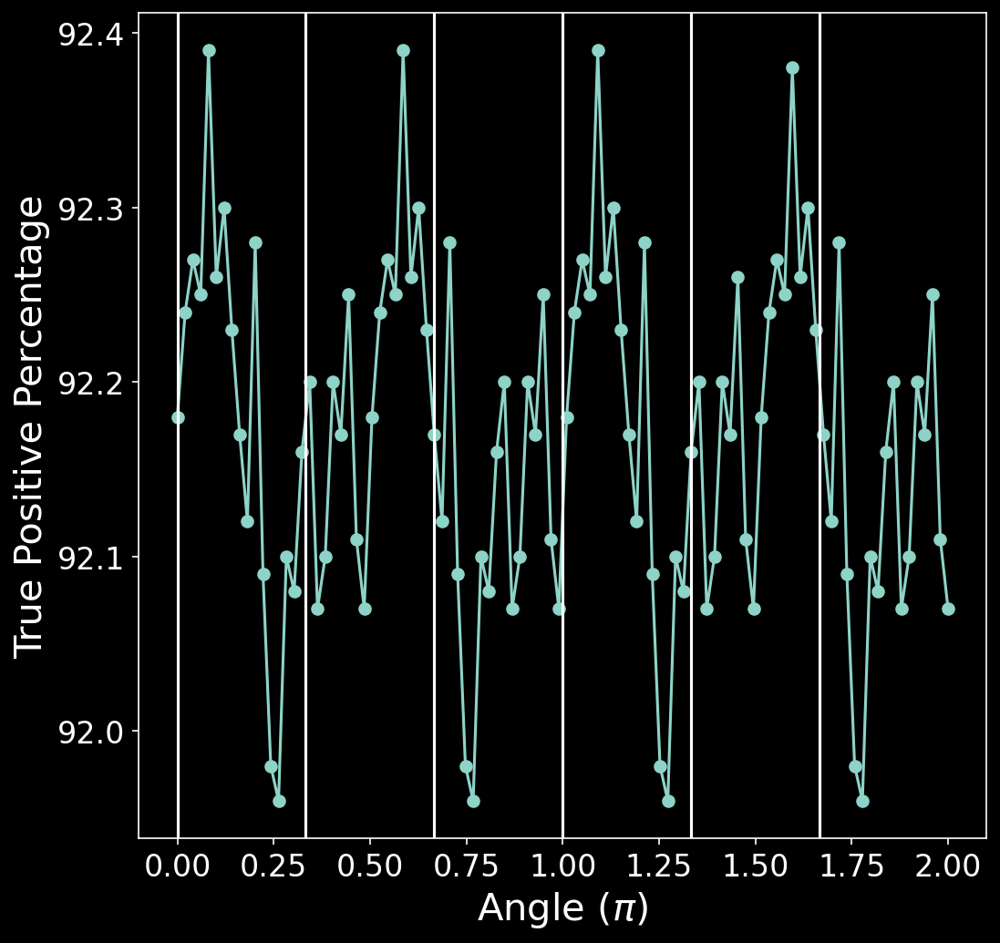

In [181]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_angles), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0.333)
plt.axvline(x=0.666)
plt.axvline(x=1)
plt.axvline(x=1.333)
plt.axvline(x=1.666)
plt.axvline(x=0)

In [6]:
mnist_DHC_out_sizetrain = hd5_open('../from_cannon/2021_01_22/mnist_DHC_train_ang_0_3.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../from_cannon/2021_01_23/mnist_DHC_test_ang_0_3.h5','main/data')
mnist_DHC_out_size_iso = DHC_iso_vec(mnist_DHC_out_sizetest,6,8)
mnist_DHC_out_size_iso.shape, mnist_DHC_out_sizetest.shape

((1000000, 310), (1000000, 2452))

In [7]:
mnist_DHC_out_size_iso_reshape = mnist_DHC_out_size_iso.reshape(10000,100,310)
angles_std = np.std(mnist_DHC_out_size_iso_reshape,axis=1)
np.mean(angles_std)

7.56012896407365e-05

In [8]:
prec_mnist_angles = []

N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain,6,8), np.repeat(mnist_train_y,6))
    
prec_mnist_angles = []
for i in range(100):
    prec_mnist_angles.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],6,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_angles)), np.std(100*np.array(prec_mnist_angles))

(87.4049, 0.40128666810647917)

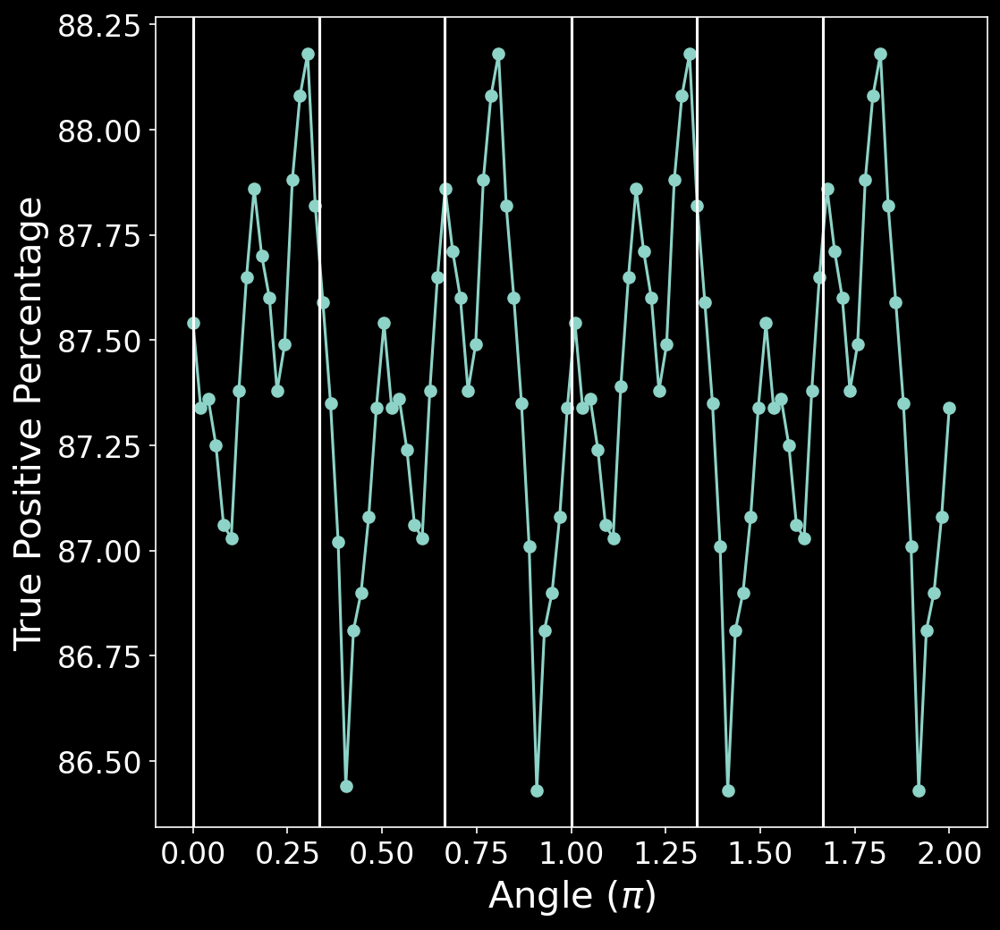

In [9]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_angles), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0.333)
plt.axvline(x=0.666)
plt.axvline(x=1)
plt.axvline(x=1.333)
plt.axvline(x=1.666)
plt.axvline(x=0)

In [10]:
mnist_DHC_out_sizetrain = hd5_open('../from_cannon/2021_01_22/mnist_DHC_train_ang_1_2.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../from_cannon/2021_01_23/mnist_DHC_test_ang_1_2.h5','main/data')
mnist_DHC_out_size_iso = DHC_iso_vec(mnist_DHC_out_sizetest,6,8)
mnist_DHC_out_size_iso.shape, mnist_DHC_out_sizetest.shape

((1000000, 310), (1000000, 2452))

In [11]:
mnist_DHC_out_size_iso_reshape = mnist_DHC_out_size_iso.reshape(10000,100,310)
angles_std = np.std(mnist_DHC_out_size_iso_reshape,axis=1)
np.mean(angles_std)

2.0105284557001678e-05

In [12]:
prec_mnist_angles = []

N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain,6,8), np.repeat(mnist_train_y,6))
    
prec_mnist_angles = []
for i in range(100):
    prec_mnist_angles.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],6,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_angles)), np.std(100*np.array(prec_mnist_angles))

(91.99520000000001, 0.14020328098871115)

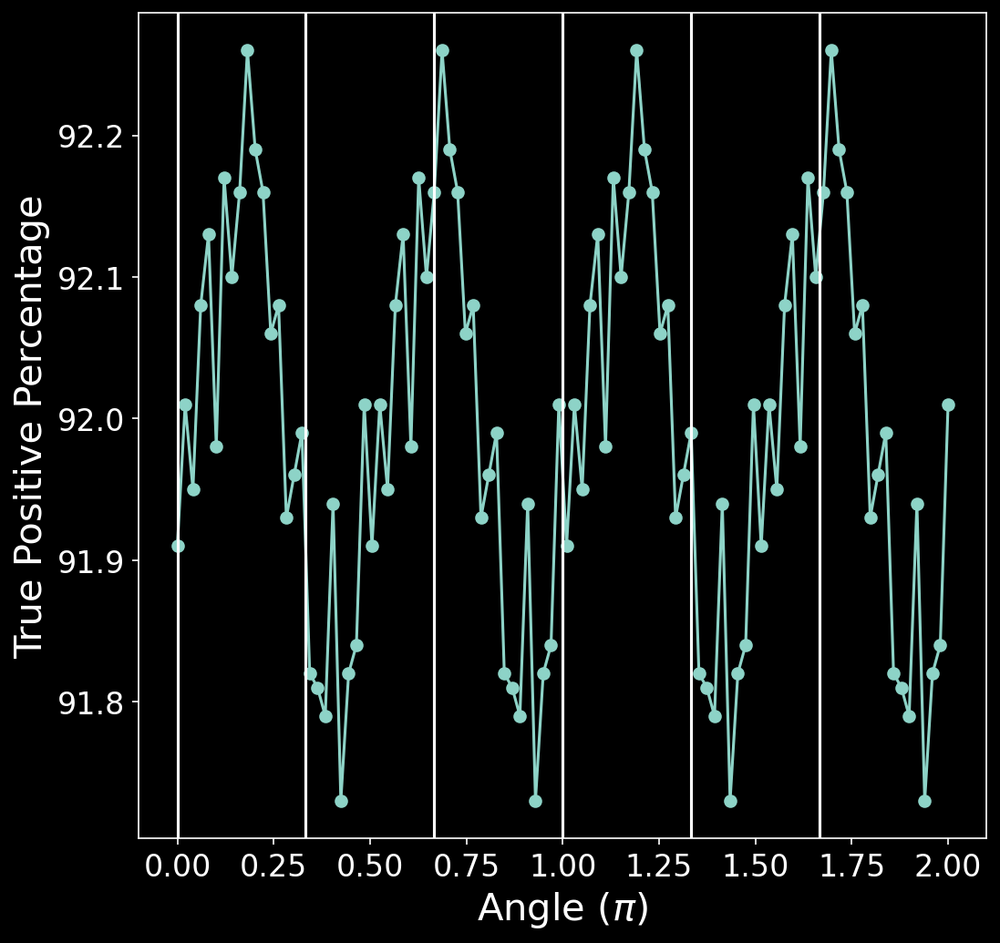

In [13]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_angles), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0.333)
plt.axvline(x=0.666)
plt.axvline(x=1)
plt.axvline(x=1.333)
plt.axvline(x=1.666)
plt.axvline(x=0)

In [15]:
mnist_DHC_out_size_iso.shape

(10000, 310)

In [16]:
mnist_DHC_out_sizetrain = hd5_open('../from_cannon/2021_01_21/mnist_DHC_train_ang_1_1.h5','main/data')
mnist_DHC_out_sizetest = hd5_open('../from_cannon/2021_01_21/mnist_DHC_test_ang_1_1.h5','main/data')
mnist_DHC_out_size_iso = DHC_iso_vec(mnist_DHC_out_sizetest,5,8)
mnist_DHC_out_size_iso_reshape = mnist_DHC_out_size_iso.reshape(10000,100,219)

In [30]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain,5,8), np.repeat(mnist_train_y,6))
    
prec_mnist_6x = []
for i in range(100):
    prec_mnist_6x.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_6x)), np.std(100*np.array(prec_mnist_6x))

(91.0355, 0.15646325447209622)

In [19]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[0::2,:],5,8), np.repeat(mnist_train_y,3))

prec_mnist_3x1 = []
for i in range(100):
    prec_mnist_3x1.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_3x1)), np.std(100*np.array(prec_mnist_3x1))

(91.0281, 0.21969840691274736)

In [20]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[1::2,:],5,8), np.repeat(mnist_train_y,3))

prec_mnist_3x2 = []
for i in range(100):
    prec_mnist_3x2.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_3x2)), np.std(100*np.array(prec_mnist_3x2))

(91.03300000000002, 0.12538341198101047)

In [21]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[0::3,:],5,8), np.repeat(mnist_train_y,2))

prec_mnist_2x1 = []
for i in range(100):
    prec_mnist_2x1.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x1)), np.std(100*np.array(prec_mnist_2x1))

(86.74650000000001, 4.398287251874302)

In [22]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[1::3,:],5,8), np.repeat(mnist_train_y,2))

prec_mnist_2x2 = []
for i in range(100):
    prec_mnist_2x2.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x2)), np.std(100*np.array(prec_mnist_2x2))

(87.81109999999998, 3.43749615127057)

In [23]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[2::3,:],5,8), np.repeat(mnist_train_y,2))

prec_mnist_2x3 = []
for i in range(100):
    prec_mnist_2x3.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x3)), np.std(100*np.array(prec_mnist_2x3))

(87.47050000000002, 3.7355490560291127)

In [24]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8), mnist_train_y)

prec_mnist_1x1 = []
for i in range(100):
    prec_mnist_1x1.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x1)), np.std(100*np.array(prec_mnist_1x1))

(86.59979999999997, 4.482527630701231)

In [25]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[1::6,:],5,8), mnist_train_y)

prec_mnist_1x2 = []
for i in range(100):
    prec_mnist_1x2.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x2)), np.std(100*np.array(prec_mnist_1x2))

(87.81099999999998, 3.437335741530057)

In [26]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[2::6,:],5,8), mnist_train_y)

prec_mnist_1x3 = []
for i in range(100):
    prec_mnist_1x3.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x3)), np.std(100*np.array(prec_mnist_1x3))

(87.47070000000002, 3.7353544021953256)

In [27]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[3::6,:],5,8), mnist_train_y)

prec_mnist_1x4 = []
for i in range(100):
    prec_mnist_1x4.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x4)), np.std(100*np.array(prec_mnist_1x4))

(86.4885, 4.613582853921668)

In [28]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[4::6,:],5,8), mnist_train_y)

prec_mnist_1x5 = []
for i in range(100):
    prec_mnist_1x5.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x5)), np.std(100*np.array(prec_mnist_1x5))

(87.81099999999998, 3.437717120415812)

In [29]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(DHC_iso_vec(mnist_DHC_out_sizetrain[5::6,:],5,8), mnist_train_y)

prec_mnist_1x6 = []
for i in range(100):
    prec_mnist_1x6.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x6)), np.std(100*np.array(prec_mnist_1x6))

(87.47040000000001, 3.735956348781393)

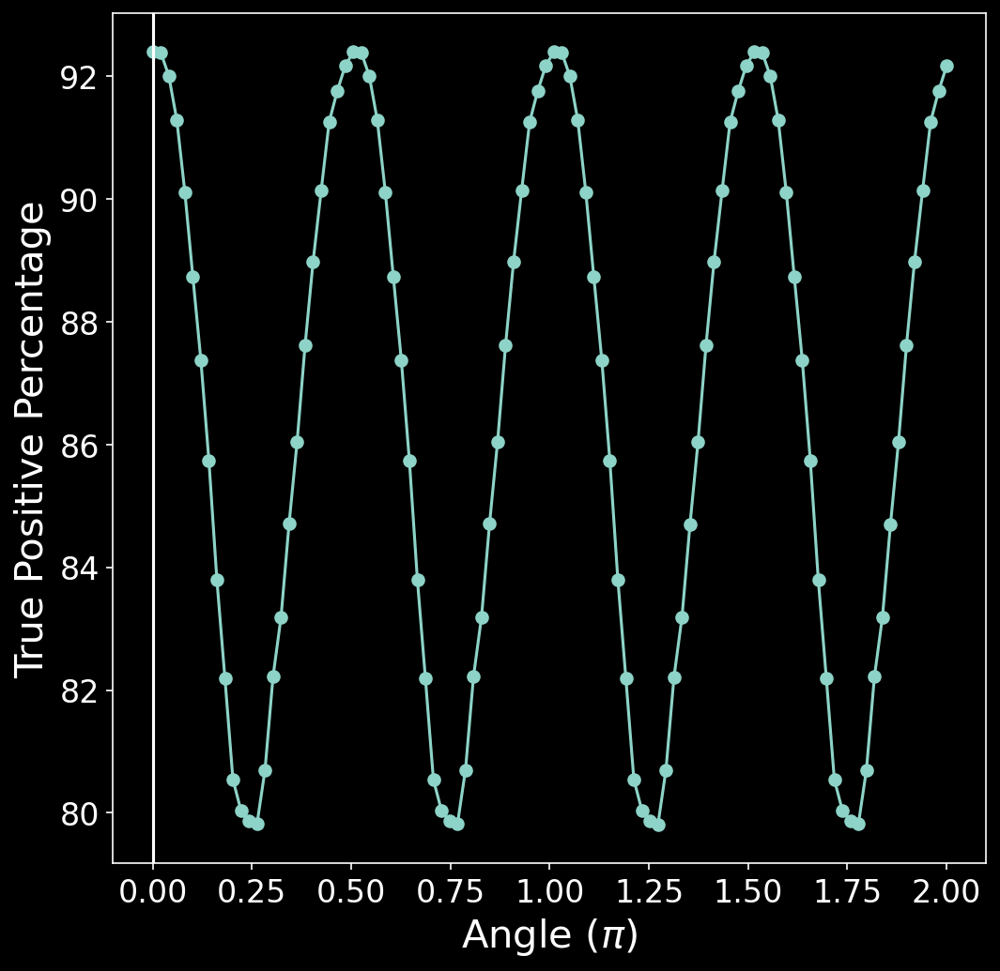

In [39]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_1x1), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

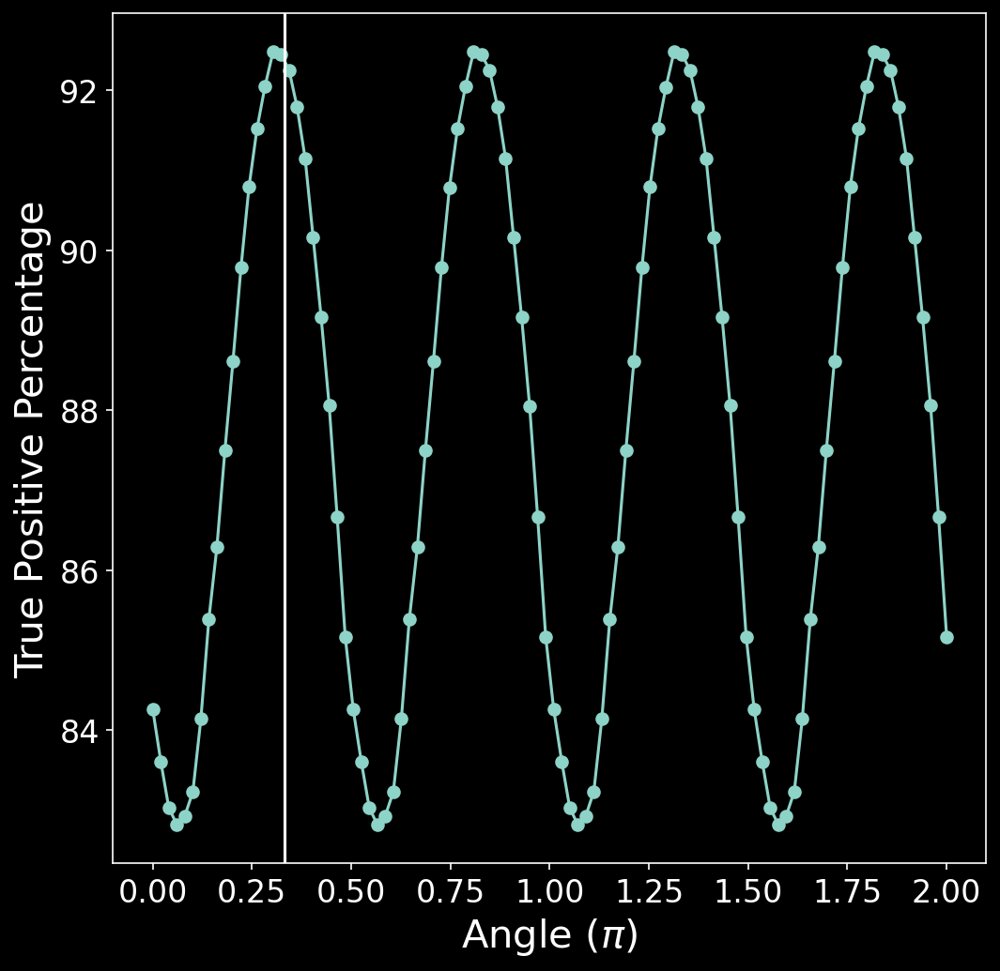

In [40]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_1x2), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

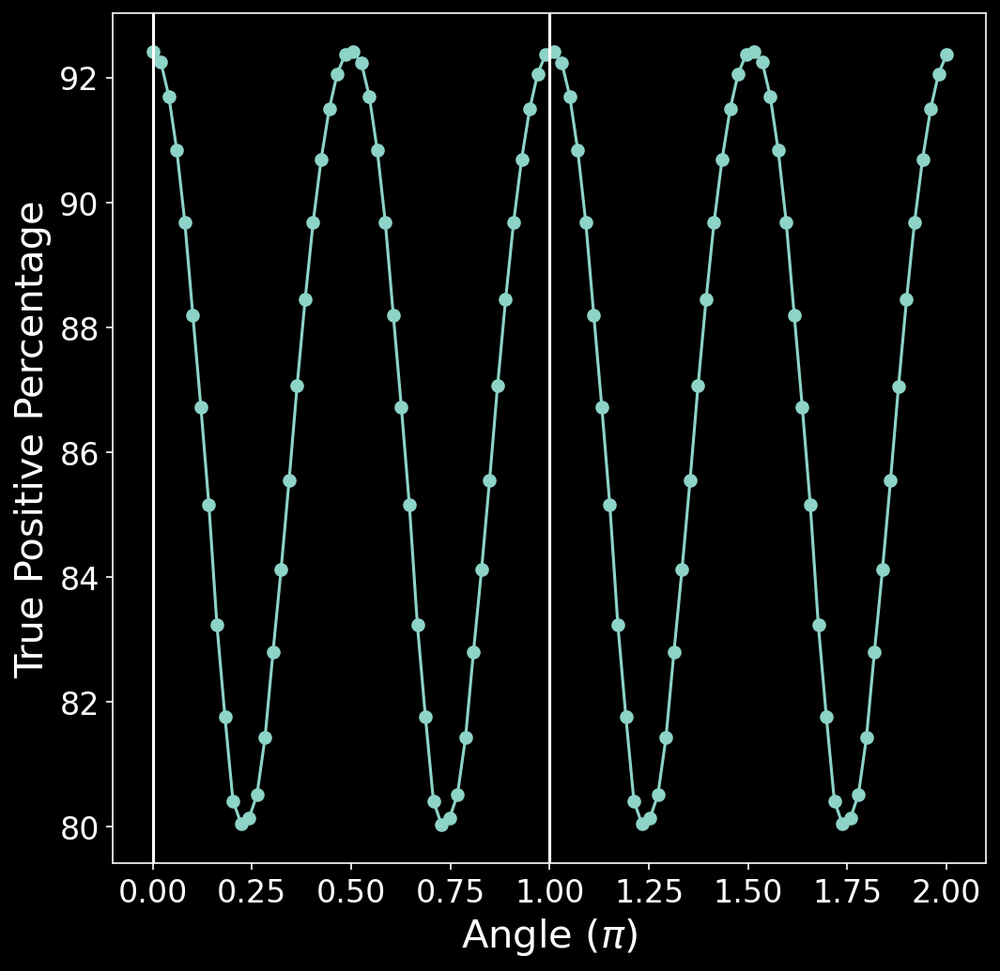

In [42]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2x1), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

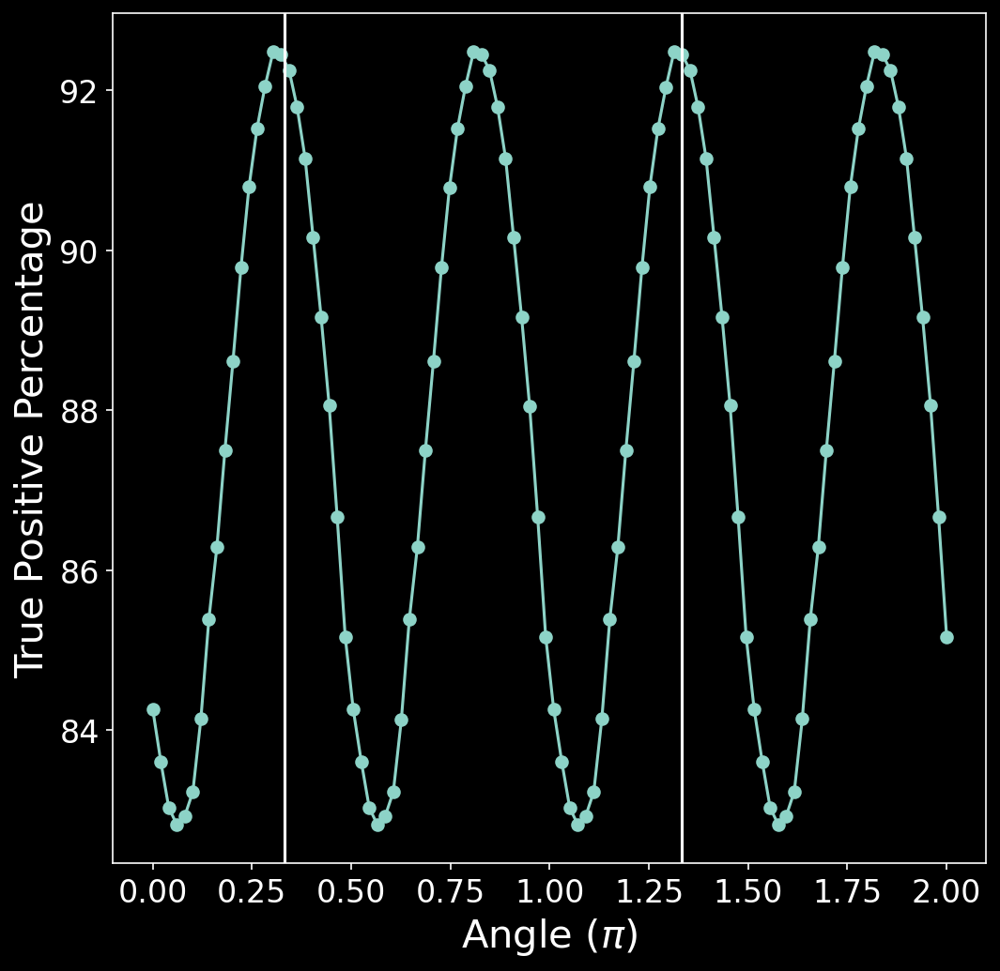

In [43]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2x2), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
plt.axvline(x=1.333)
#plt.axvline(x=1.666)

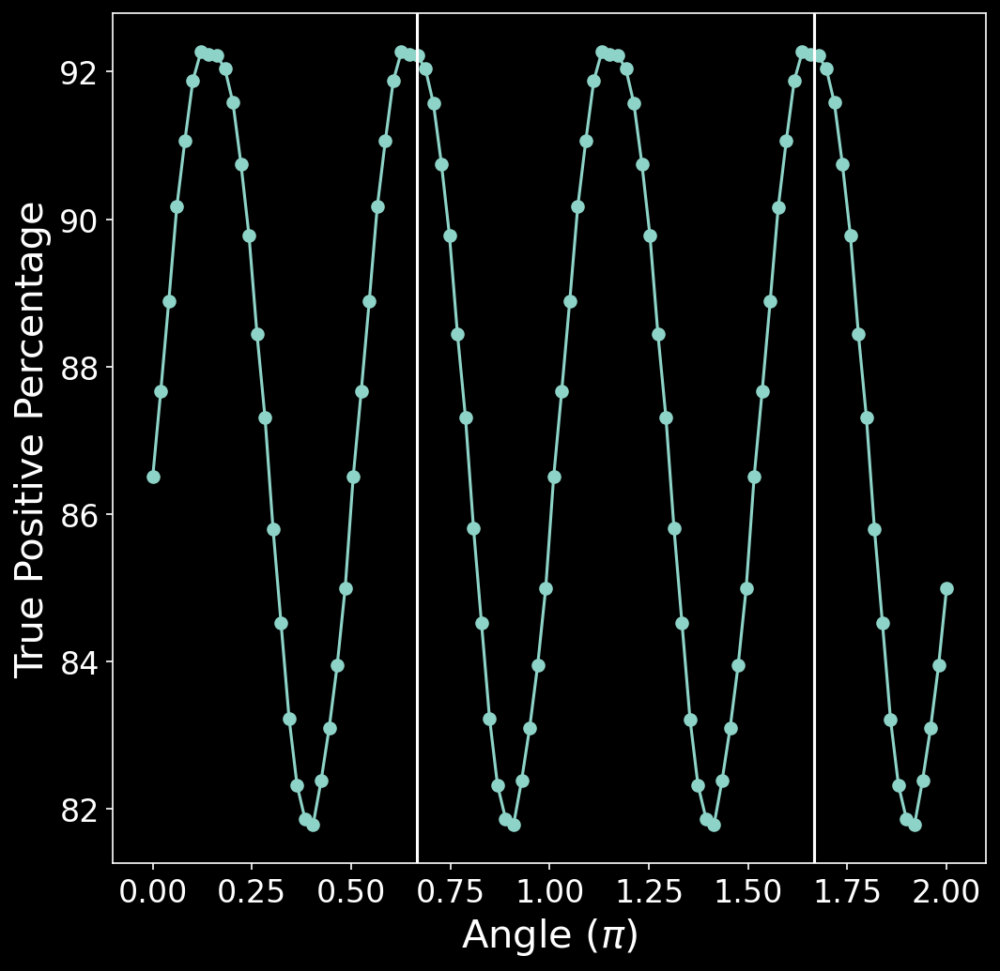

In [45]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2x3), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
#plt.axvline(x=0.333)
plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
plt.axvline(x=1.666)

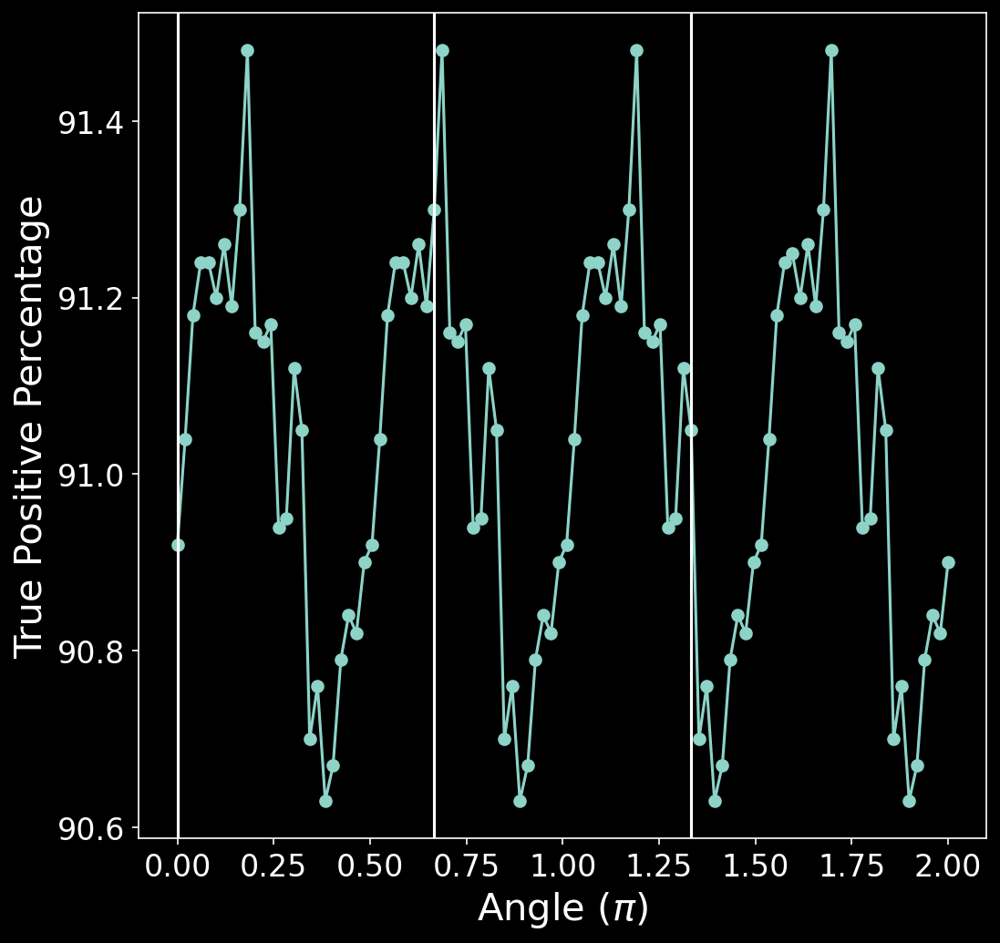

In [46]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_3x1), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
plt.axvline(x=0.666)
#plt.axvline(x=1)
plt.axvline(x=1.333)
#plt.axvline(x=1.666)

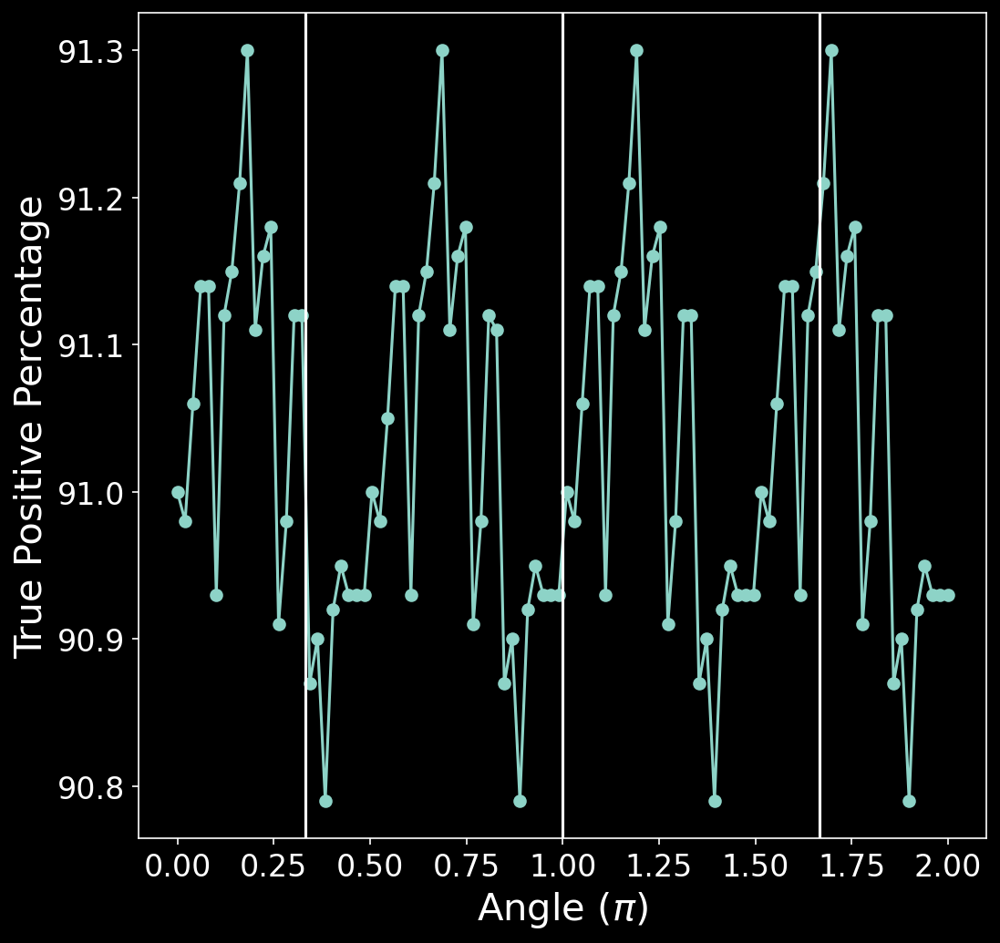

In [47]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_3x2), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
plt.axvline(x=1.666)

In [52]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8),DHC_iso_vec(mnist_DHC_out_sizetrain[1::6,:],5,8))), np.tile(mnist_train_y,2))

prec_mnist_2_sep_1 = []
for i in range(100):
    prec_mnist_2_sep_1.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_1)), np.std(100*np.array(prec_mnist_2_sep_1))

(90.80560000000001, 0.5535419044661389)

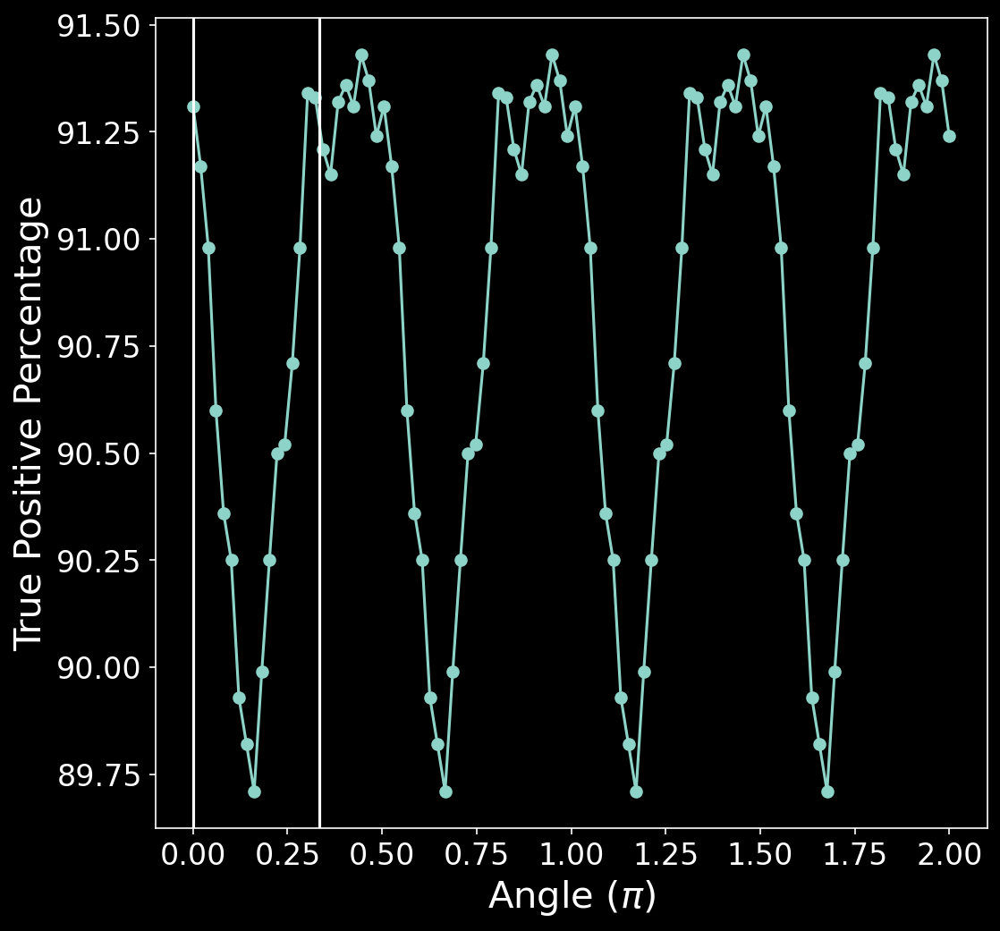

In [53]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_1), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

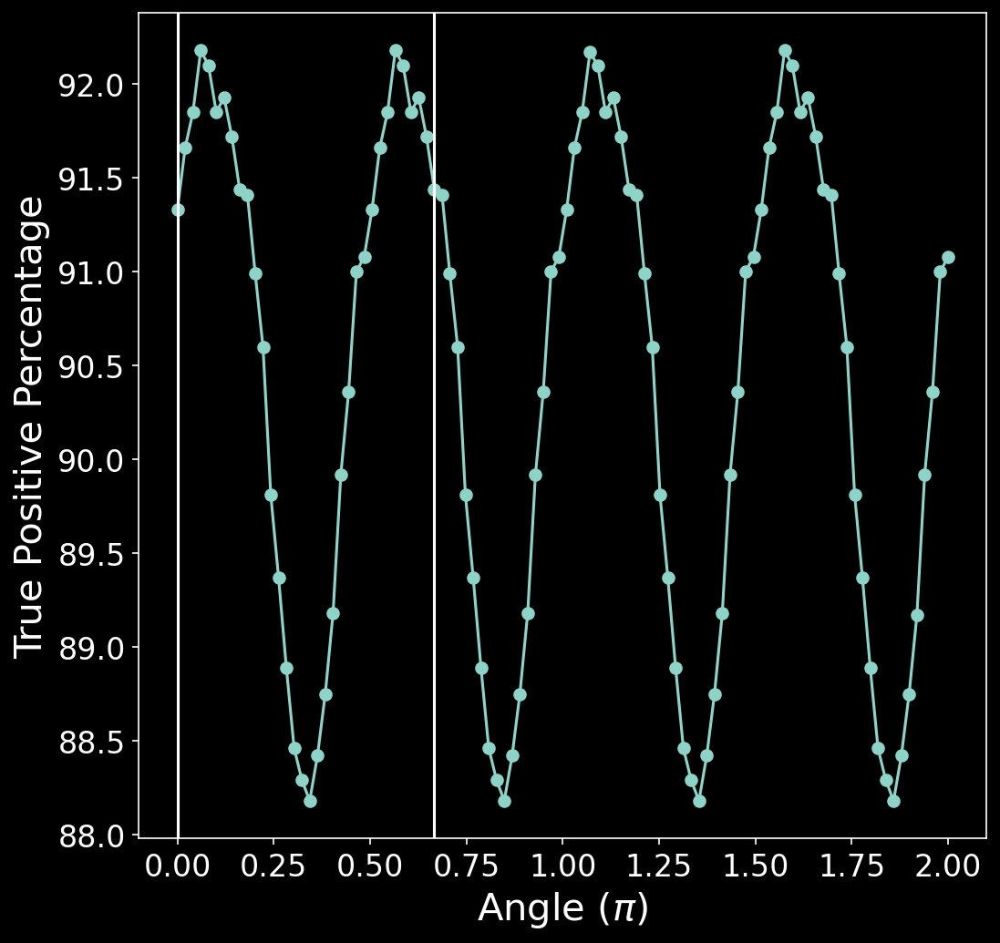

In [59]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_2), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

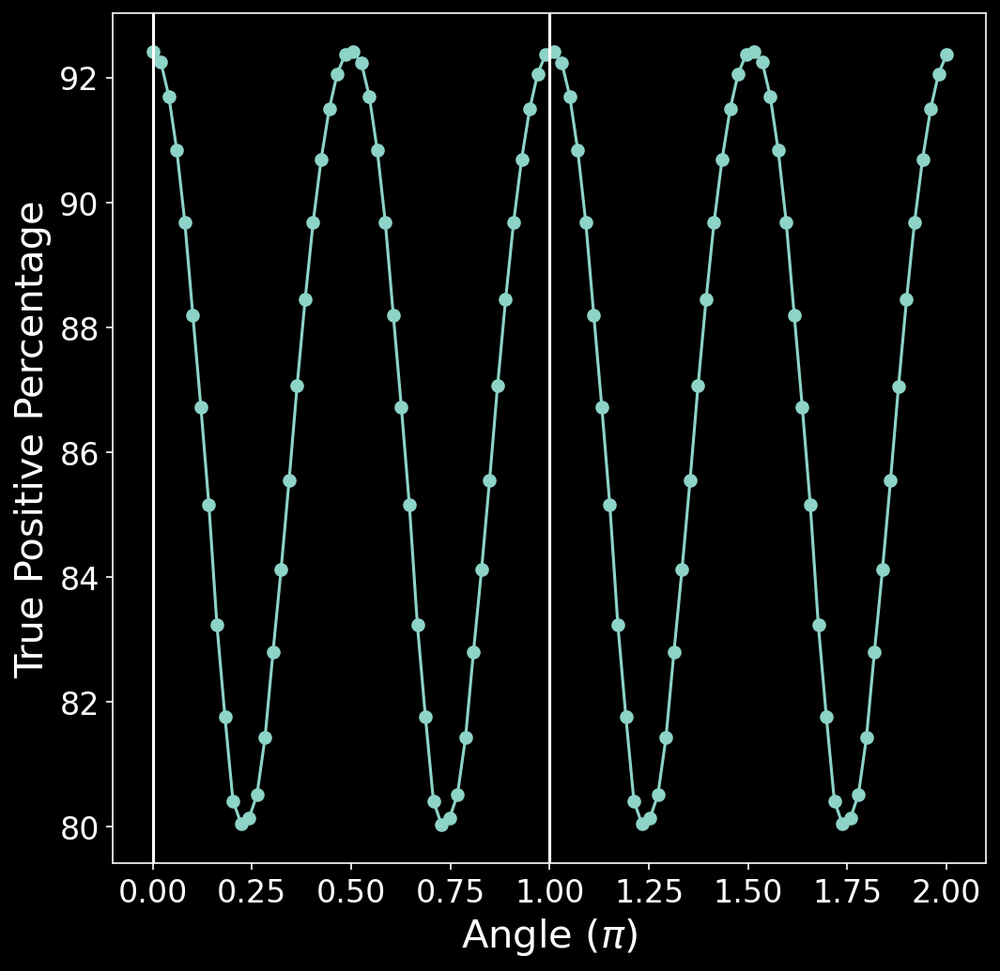

In [60]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_3), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

In [54]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8),DHC_iso_vec(mnist_DHC_out_sizetrain[2::6,:],5,8))), np.tile(mnist_train_y,2))

prec_mnist_2_sep_2 = []
for i in range(100):
    prec_mnist_2_sep_2.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_2)), np.std(100*np.array(prec_mnist_2_sep_2))

(90.43060000000001, 1.345834179979092)

In [55]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8),DHC_iso_vec(mnist_DHC_out_sizetrain[4::6,:],5,8))), np.tile(mnist_train_y,2))

prec_mnist_2_sep_4 = []
for i in range(100):
    prec_mnist_2_sep_4.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_4)), np.std(100*np.array(prec_mnist_2_sep_4))

(90.80560000000001, 0.5535419044661389)

In [56]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8),DHC_iso_vec(mnist_DHC_out_sizetrain[5::6,:],5,8))), np.tile(mnist_train_y,2))

prec_mnist_2_sep_5 = []
for i in range(100):
    prec_mnist_2_sep_5.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_5)), np.std(100*np.array(prec_mnist_2_sep_5))

(90.43050000000001, 1.3457045552423443)

In [57]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((DHC_iso_vec(mnist_DHC_out_sizetrain[0::6,:],5,8),DHC_iso_vec(mnist_DHC_out_sizetrain[3::6,:],5,8))), np.tile(mnist_train_y,2))

prec_mnist_2_sep_3 = []
for i in range(100):
    prec_mnist_2_sep_3.append(prec_LDA(lda,DHC_iso_vec(mnist_DHC_out_sizetest[i::100,:],5,8),mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_3)), np.std(100*np.array(prec_mnist_2_sep_3))

(86.74650000000001, 4.398287251874302)

In [64]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain, np.repeat(mnist_train_y,6))

prec_mnist_6xr = []
for i in range(100):
    prec_mnist_6xr.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_6xr)), np.std(100*np.array(prec_mnist_6xr))

(87.99319999999997, 4.454072267038333)

In [62]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[0::2,:], np.repeat(mnist_train_y,3))

prec_mnist_3x1r = []
for i in range(100):
    prec_mnist_3x1r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_3x1r)), np.std(100*np.array(prec_mnist_3x1r))

(87.7861, 4.79389004775871)

In [63]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[1::2,:], np.repeat(mnist_train_y,3))

prec_mnist_3x2r = []
for i in range(100):
    prec_mnist_3x2r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_3x2r)), np.std(100*np.array(prec_mnist_3x2r))

(87.883, 4.441861434128714)

In [65]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[0::3,:], np.repeat(mnist_train_y,2))

prec_mnist_2x1r = []
for i in range(100):
    prec_mnist_2x1r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x1r)), np.std(100*np.array(prec_mnist_2x1r))

(50.04370000000001, 30.759720891288985)

In [66]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[1::3,:], np.repeat(mnist_train_y,2))

prec_mnist_2x2r = []
for i in range(100):
    prec_mnist_2x2r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x2r)), np.std(100*np.array(prec_mnist_2x2r))

(50.27660000000001, 29.69063826259045)

In [67]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[2::3,:], np.repeat(mnist_train_y,2))

prec_mnist_2x3r = []
for i in range(100):
    prec_mnist_2x3r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2x3r)), np.std(100*np.array(prec_mnist_2x3r))

(50.0001, 30.237980835201284)

In [68]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[0::6,:],mnist_train_y)

prec_mnist_1x1r = []
for i in range(100):
    prec_mnist_1x1r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x1r)), np.std(100*np.array(prec_mnist_1x1r))

(49.523999999999994, 30.656225534139065)

In [69]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[1::6,:],mnist_train_y)

prec_mnist_1x2r = []
for i in range(100):
    prec_mnist_1x2r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x2r)), np.std(100*np.array(prec_mnist_1x2r))

(50.2755, 29.69130385735864)

In [70]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[2::6,:],mnist_train_y)

prec_mnist_1x3r = []
for i in range(100):
    prec_mnist_1x3r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x3r)), np.std(100*np.array(prec_mnist_1x3r))

(49.9999, 30.238190901408107)

In [71]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[3::6,:],mnist_train_y)

prec_mnist_1x4r = []
for i in range(100):
    prec_mnist_1x4r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x4r)), np.std(100*np.array(prec_mnist_1x4r))

(49.4734, 30.483136427211683)

In [72]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[4::6,:],mnist_train_y)

prec_mnist_1x5r = []
for i in range(100):
    prec_mnist_1x5r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x5r)), np.std(100*np.array(prec_mnist_1x5r))

(50.2759, 29.691565977394998)

In [73]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(mnist_DHC_out_sizetrain[5::6,:],mnist_train_y)

prec_mnist_1x6r = []
for i in range(100):
    prec_mnist_1x6r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_1x6r)), np.std(100*np.array(prec_mnist_1x6r))

(49.99969999999999, 30.23846657669664)

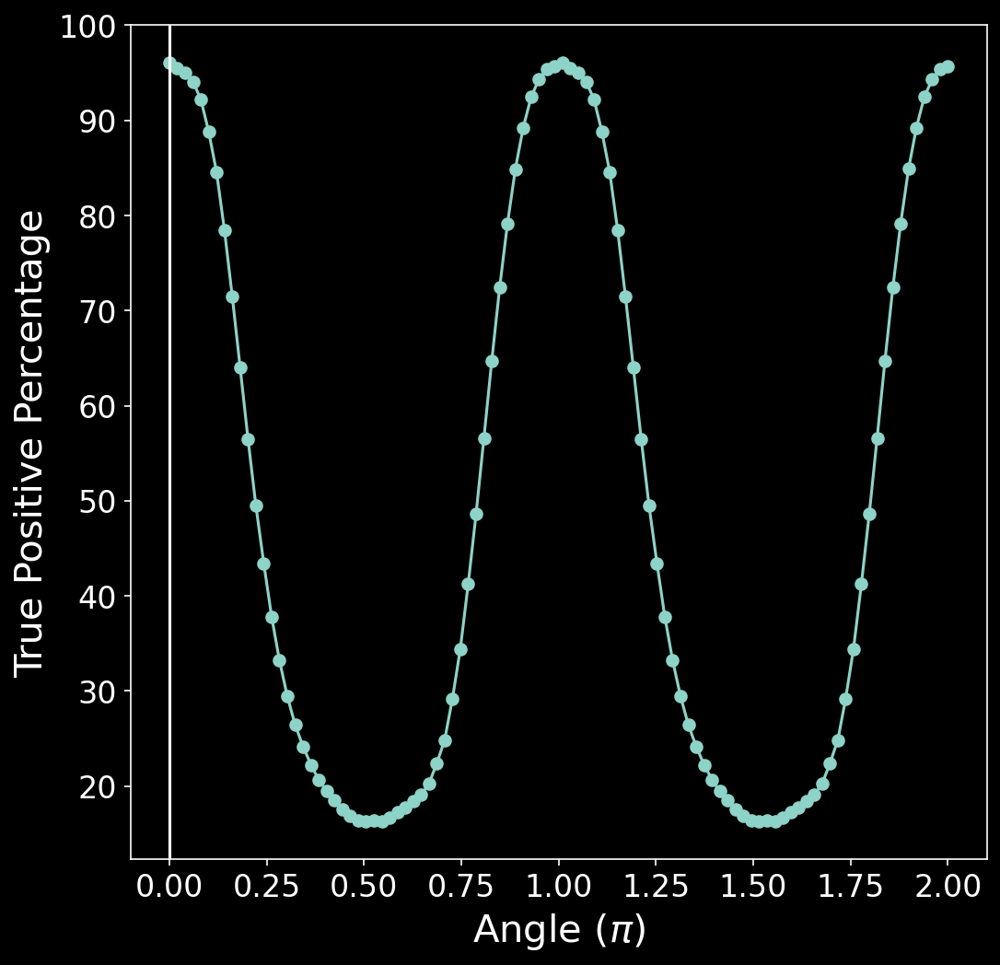

In [74]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_1x1r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

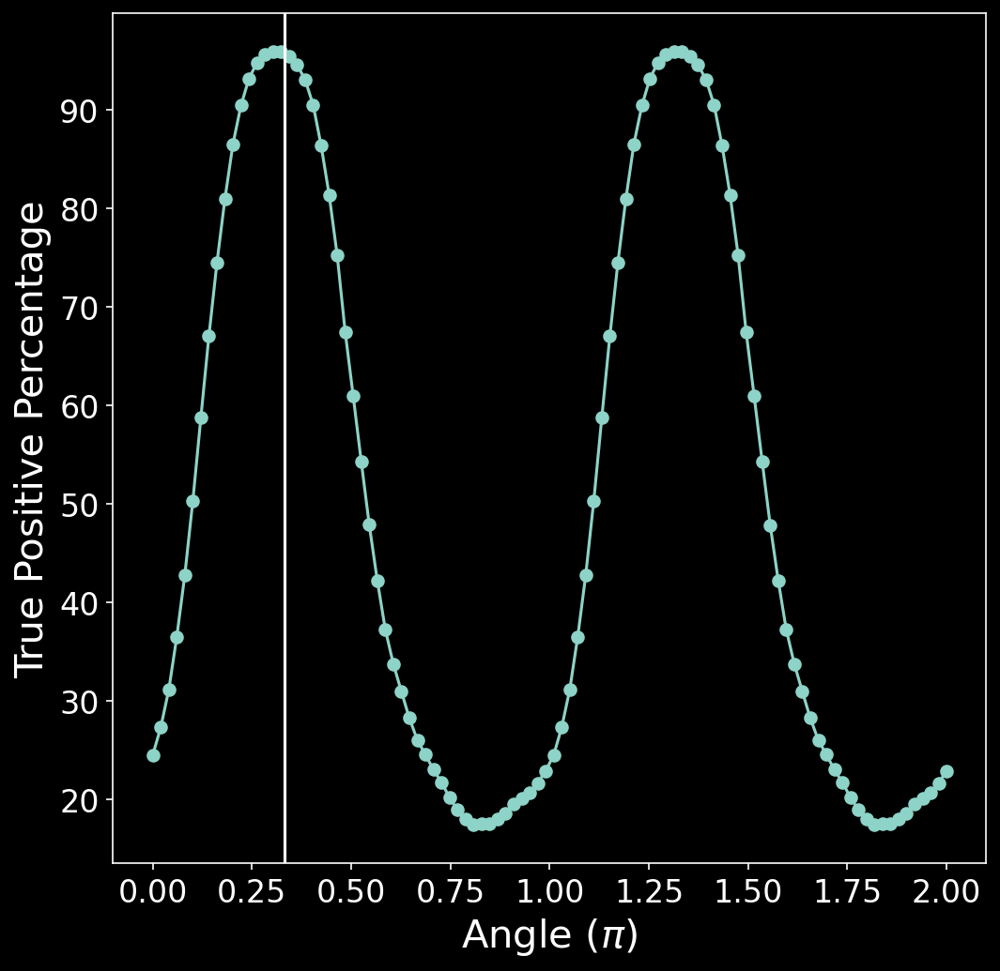

In [75]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_1x2r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

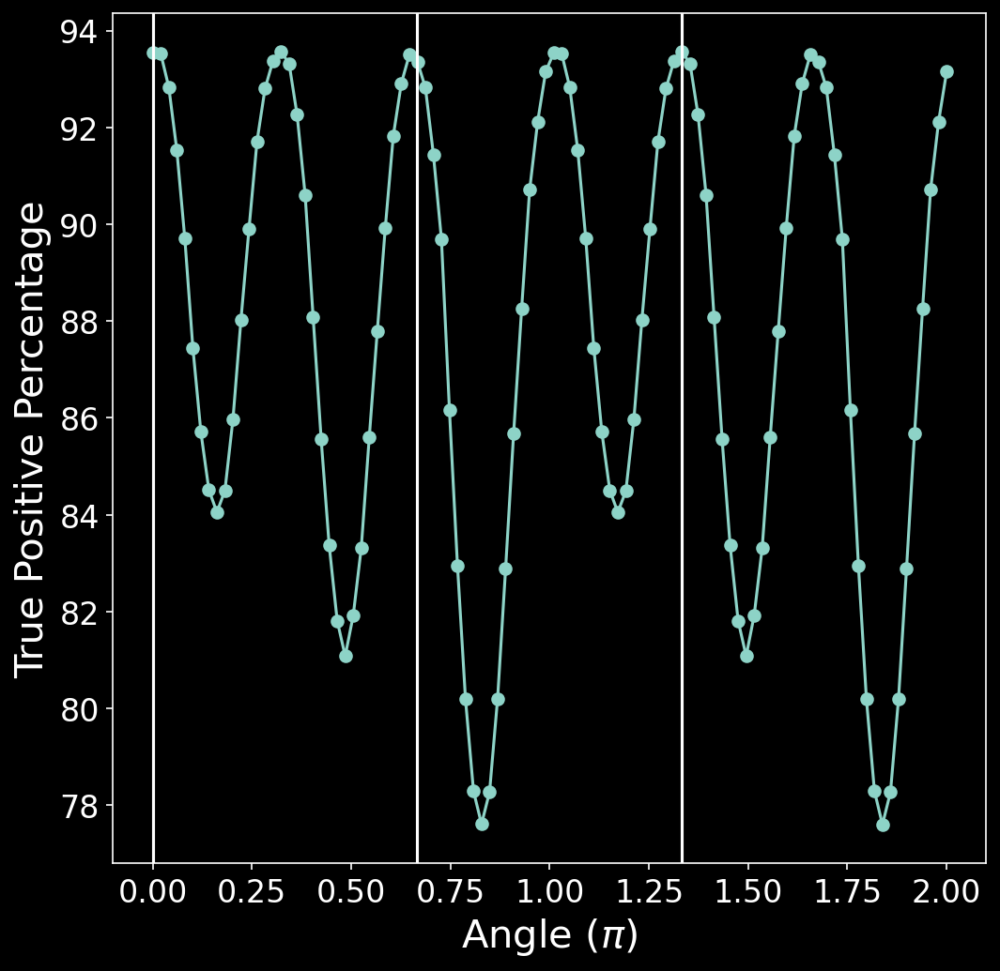

In [76]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_3x1r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
plt.axvline(x=0.666)
#plt.axvline(x=1)
plt.axvline(x=1.333)
#plt.axvline(x=1.666)

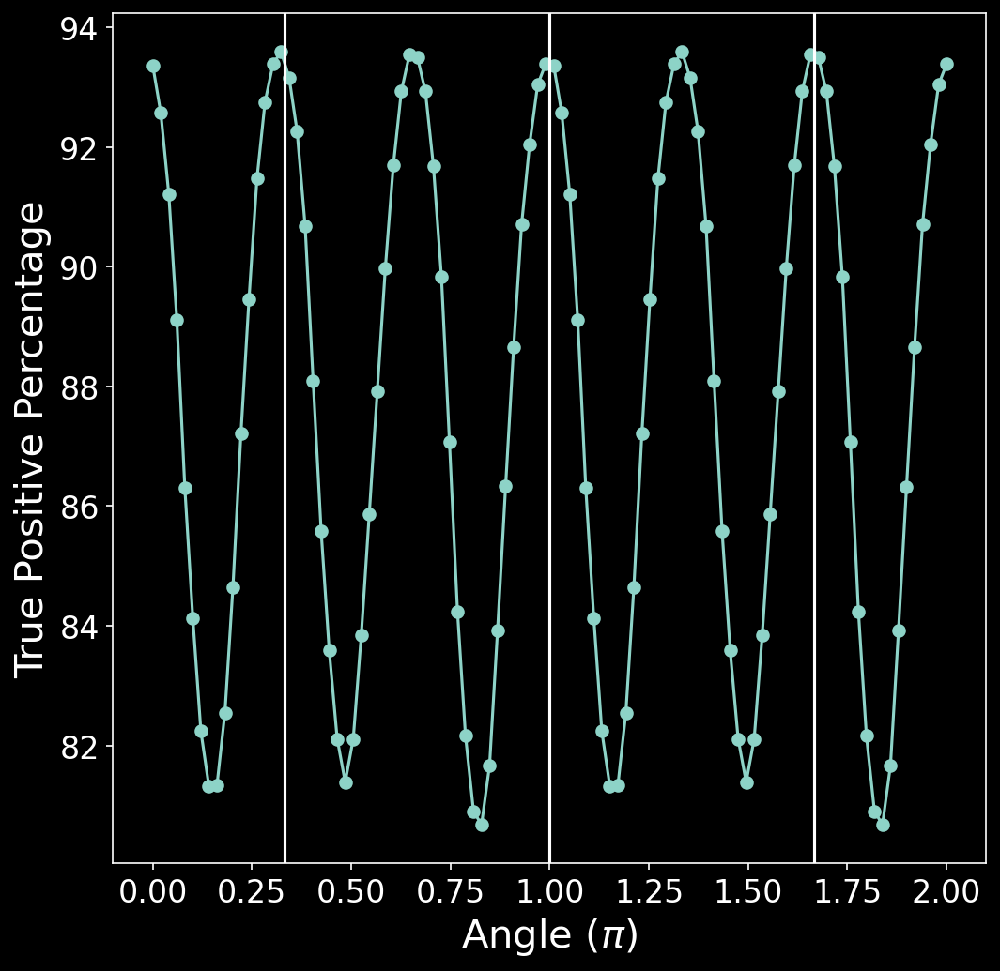

In [77]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_3x2r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
plt.axvline(x=1.666)

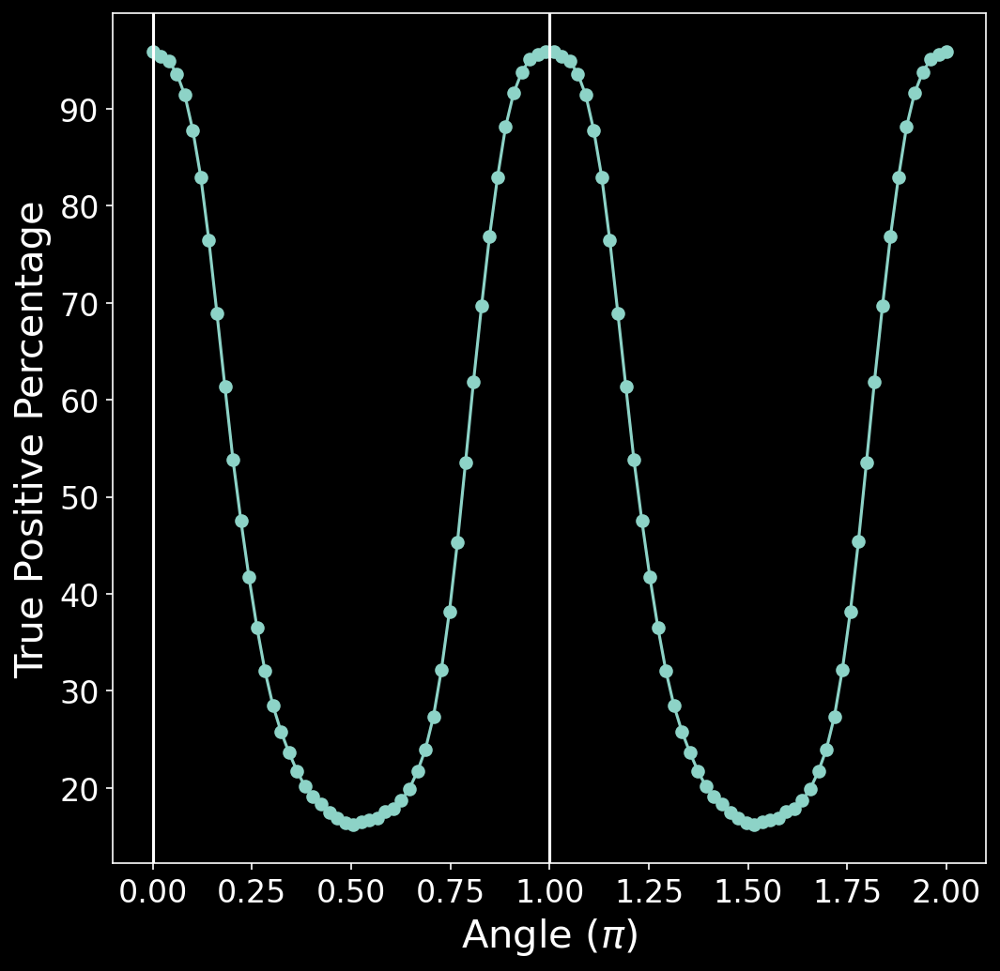

In [78]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2x1r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

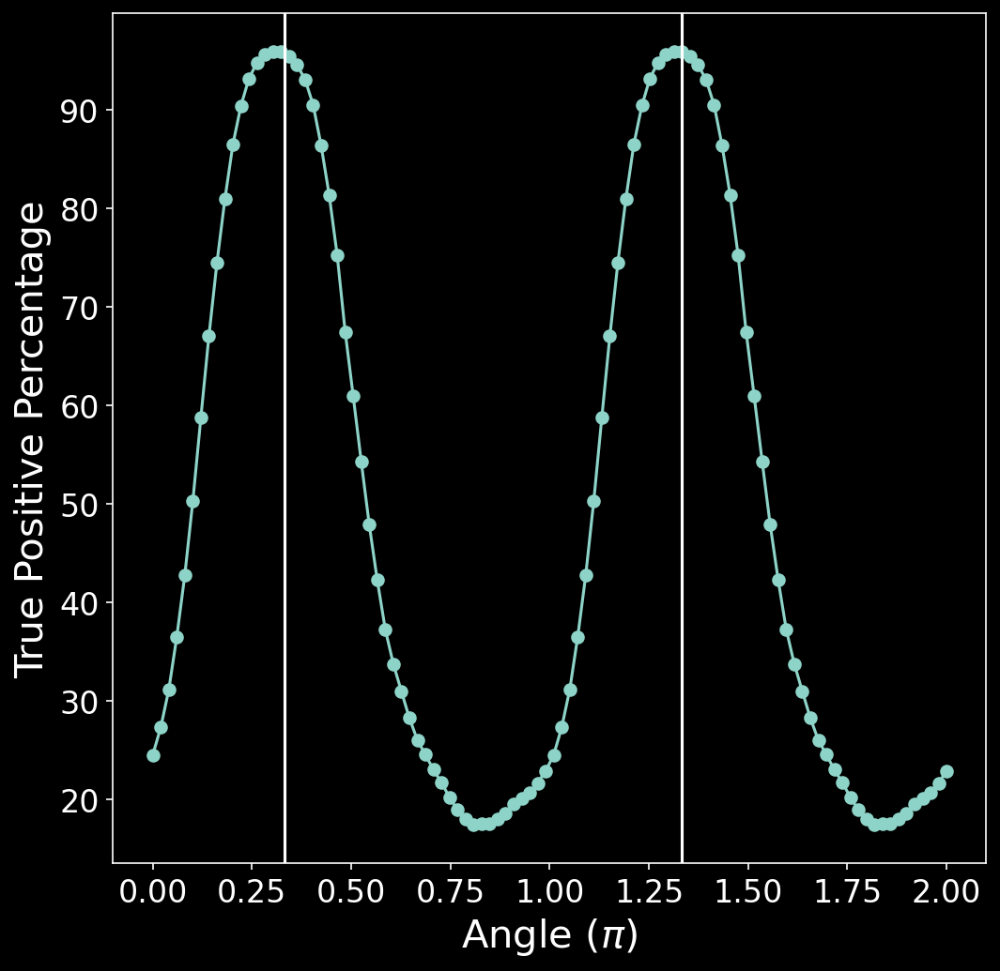

In [79]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2x2r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
#plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
plt.axvline(x=1.333)
#plt.axvline(x=1.666)

In [81]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((mnist_DHC_out_sizetrain[0::6,:],mnist_DHC_out_sizetrain[1::6,:])), np.tile(mnist_train_y,2))

prec_mnist_2_sep_1r = []
for i in range(100):
    prec_mnist_2_sep_1r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_1r)), np.std(100*np.array(prec_mnist_2_sep_1r))

(69.09700000000001, 27.039917252092323)

In [82]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((mnist_DHC_out_sizetrain[0::6,:],mnist_DHC_out_sizetrain[2::6,:])), np.tile(mnist_train_y,2))

prec_mnist_2_sep_2r = []
for i in range(100):
    prec_mnist_2_sep_2r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_2r)), np.std(100*np.array(prec_mnist_2_sep_2r))

(71.36900000000001, 24.155199916374116)

In [83]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((mnist_DHC_out_sizetrain[0::6,:],mnist_DHC_out_sizetrain[3::6,:])), np.tile(mnist_train_y,2))

prec_mnist_2_sep_3r = []
for i in range(100):
    prec_mnist_2_sep_3r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_3r)), np.std(100*np.array(prec_mnist_2_sep_3r))

(50.04370000000001, 30.759720891288985)

In [84]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((mnist_DHC_out_sizetrain[0::6,:],mnist_DHC_out_sizetrain[4::6,:])), np.tile(mnist_train_y,2))

prec_mnist_2_sep_4r = []
for i in range(100):
    prec_mnist_2_sep_4r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_4r)), np.std(100*np.array(prec_mnist_2_sep_4r))

(69.09710000000001, 27.039934700180027)

In [85]:
N = 10
lda = LDA(n_components=N-1)
lda.fit(np.vstack((mnist_DHC_out_sizetrain[0::6,:],mnist_DHC_out_sizetrain[5::6,:])), np.tile(mnist_train_y,2))

prec_mnist_2_sep_5r = []
for i in range(100):
    prec_mnist_2_sep_5r.append(prec_LDA(lda,mnist_DHC_out_sizetest[i::100,:],mnist_test_y))
    
np.mean(100*np.array(prec_mnist_2_sep_5r)), np.std(100*np.array(prec_mnist_2_sep_5r))

(71.36830000000002, 24.155440341877437)

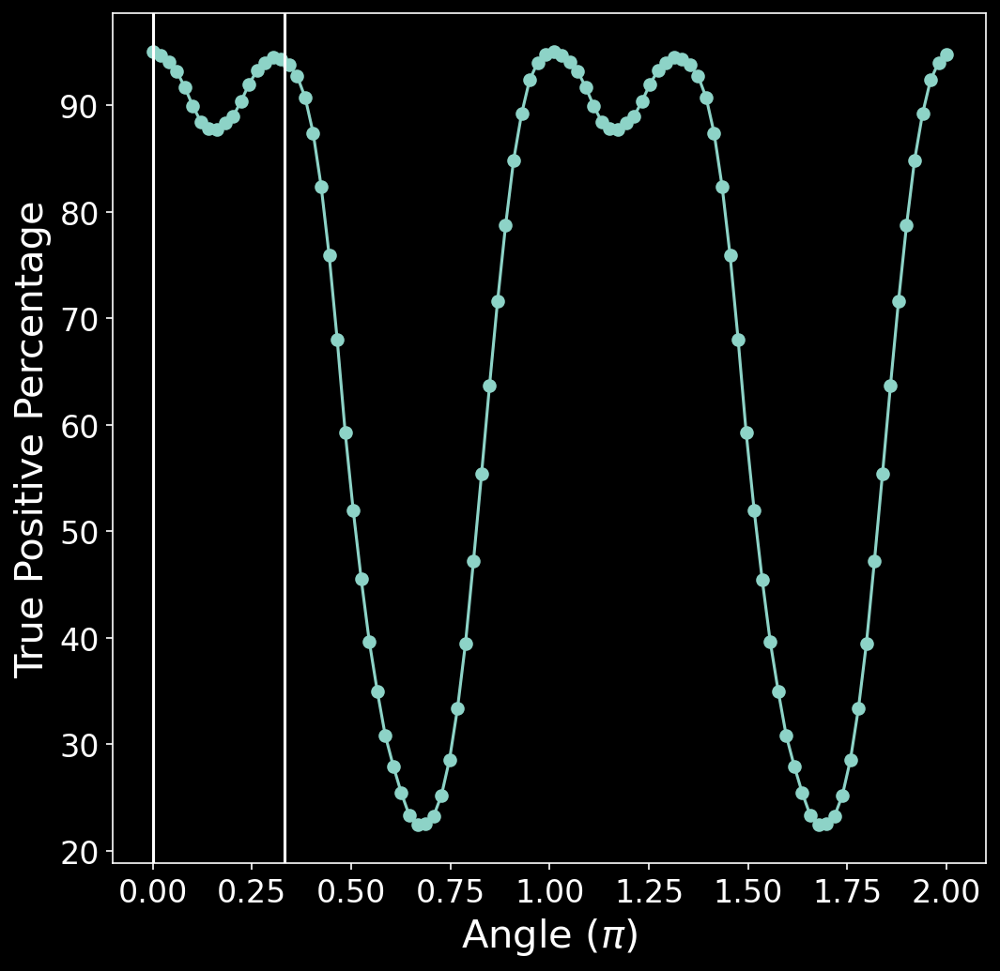

In [86]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_1r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
plt.axvline(x=0.333)
#plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

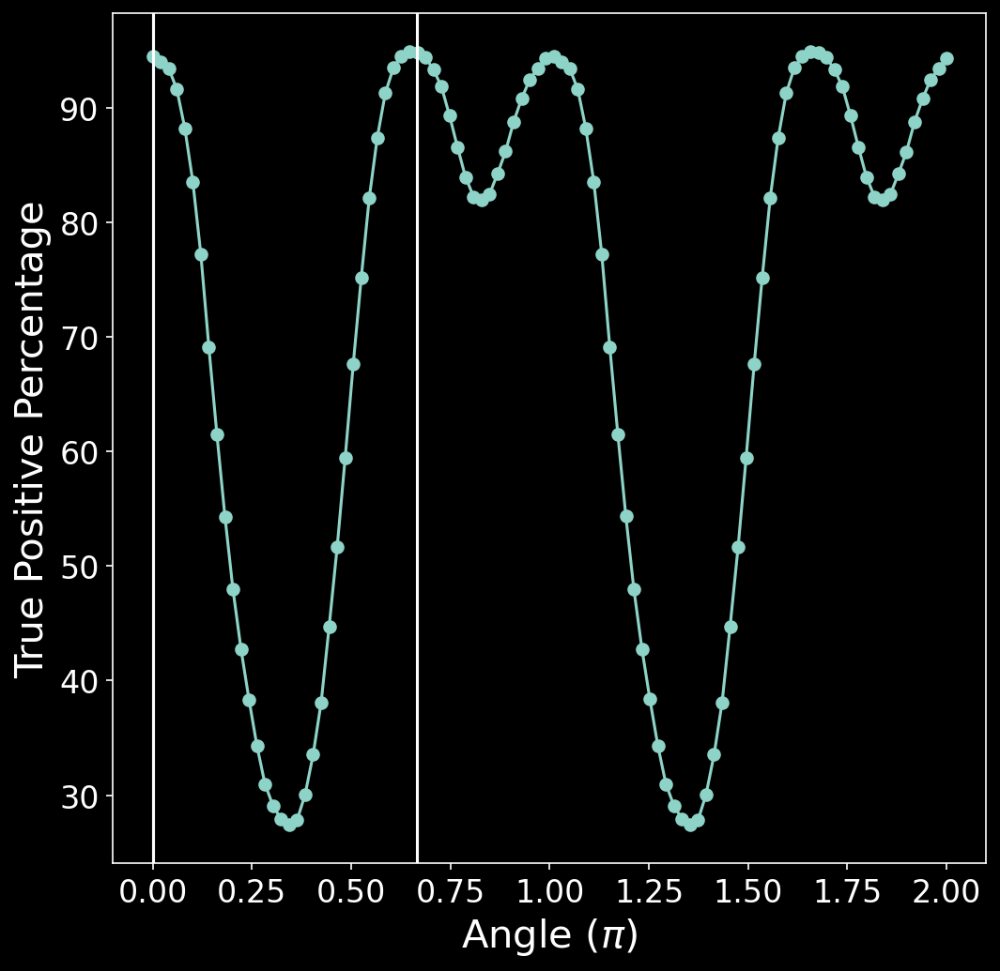

In [87]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_2r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
plt.axvline(x=0.666)
#plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

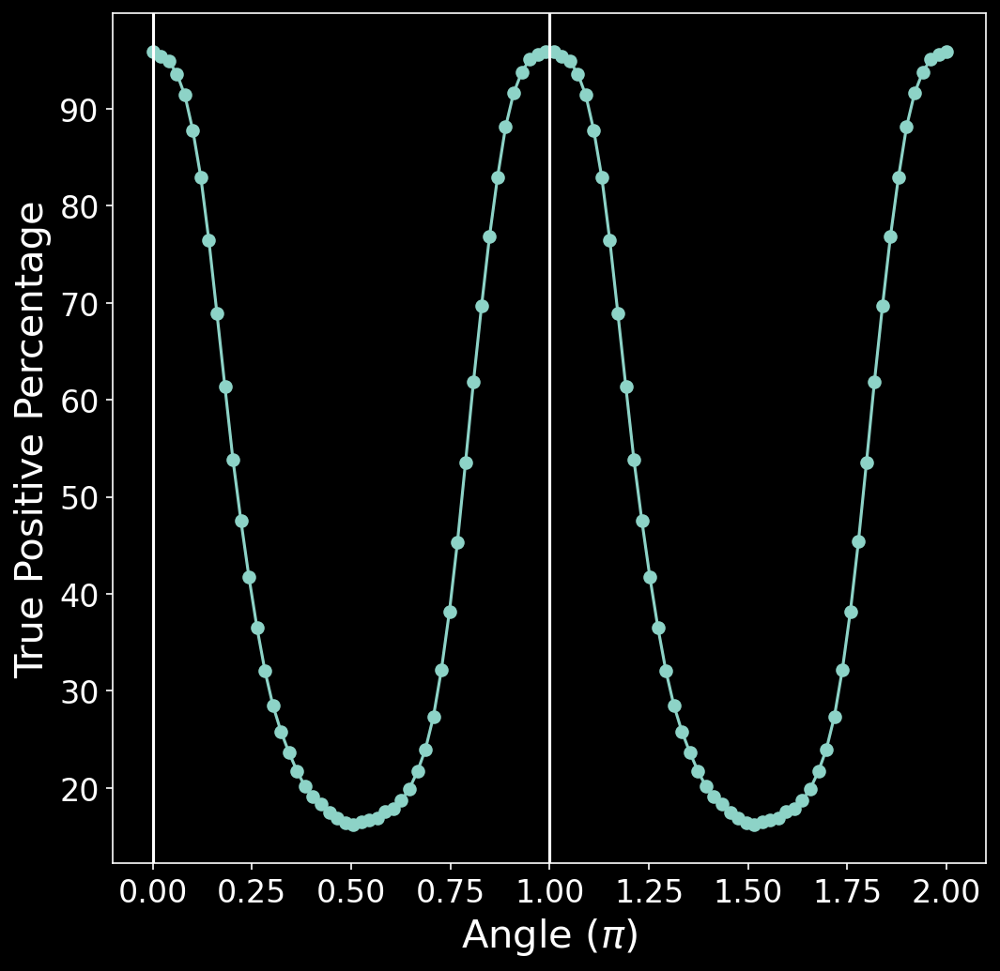

In [88]:
fig = plt.figure(figsize=(8,8),dpi=150)

ax = fig.add_subplot(111) 
ax.plot(angles,100*np.array(prec_mnist_2_sep_3r), linestyle='-', marker='o')
plt.xlabel('Angle ($\pi$)')
plt.ylabel('True Positive Percentage')
plt.axvline(x=0)
#plt.axvline(x=0.333)
#plt.axvline(x=0.666)
plt.axvline(x=1)
#plt.axvline(x=1.333)
#plt.axvline(x=1.666)

In [93]:
def DHC_dir_vec(wst,J,L):
    (nk, Nd) = np.shape(wst)
    S0 = wst[:,0:2]
    S1 = wst[:,2:J*L+2]
    S2 = np.reshape(wst[:,J*L+3:],(nk,(J*L+1),(J*L+1)))
    
    S1sin = np.zeros((nk,J))
    S1cos = np.zeros((nk,J))
    
    Sphi1sin = np.zeros((nk,J))
    Sphi1cos = np.zeros((nk,J))
    
    Sphi2sin = np.zeros((nk,J))
    Sphi2cos = np.zeros((nk,J))
    for j1 in range(J):
        for l1 in range(L):
            S1sin[:,j1] += S1[:,l1*J+j1]*np.sin(2*np.pi/L*l1)
            S1cos[:,j1] += S1[:,l1*J+j1]*np.cos(2*np.pi/L*l1)
            
            Sphi1sin[:,j1] += S2[:,l1*J+j1,L*J]*np.sin(2*np.pi/L*l1)
            Sphi1cos[:,j1] += S2[:,l1*J+j1,L*J]*np.cos(2*np.pi/L*l1)
            
            Sphi2sin[:,j1] += S2[:,L*J,l1*J+j1]*np.sin(2*np.pi/L*l1)
            Sphi2cos[:,j1] += S2[:,L*J,l1*J+j1]*np.cos(2*np.pi/L*l1)
            
    S2sinsin = np.zeros((nk,J,J))
    S2sincos = np.zeros((nk,J,J))
    S2cossin = np.zeros((nk,J,J))
    S2coscos = np.zeros((nk,J,J))
    for j1 in range(J):
        for j2 in range(J):
            for l1 in range(L):
                for l2 in range(L):
                    S2sinsin[:,j1,j2] += S2[:,l1*J+j1,l2*J+j2]*np.sin(2*np.pi/L*l1)*np.sin(2*np.pi/L*l2)
                    S2sincos[:,j1,j2] += S2[:,l1*J+j1,l2*J+j2]*np.sin(2*np.pi/L*l1)*np.cos(2*np.pi/L*l2)
                    S2cossin[:,j1,j2] += S2[:,l1*J+j1,l2*J+j2]*np.cos(2*np.pi/L*l1)*np.sin(2*np.pi/L*l2)
                    S2coscos[:,j1,j2] += S2[:,l1*J+j1,l2*J+j2]*np.cos(2*np.pi/L*l1)*np.cos(2*np.pi/L*l2)
                    
    return np.hstack((S0,
                      S1sin,
                      S1cos,
                      wst[:,J*L+2].reshape(nk,1),
                      S2sinsin.reshape(nk,J*J),
                      S2sincos.reshape(nk,J*J),
                      S2cossin.reshape(nk,J*J),
                      S2coscos.reshape(nk,J*J),
                      Sphi1sin,
                      Sphi1cos,
                      Sphi2sin,
                      Sphi2cos,
                      S2[:,L*J,L*J].reshape(nk,1)))

In [104]:
def LDA_AKS_testman(X_train,y_train,X_test,y_test,n_components,label_list):
    lda = LDA(n_components=n_components)
    X_train = lda.fit_transform(X_train, y_train)
    y_pred = lda.predict(X_test)
    X_test = lda.transform(X_test)
    cm = confusion_matrix(y_test, y_pred)
    prec = precision_score(y_test, y_pred,average='micro')
    print('Accuracy' + str(prec))
    cmap_normal = (cm.T/cm.sum(axis=1)).T
    
    ## Good plots
    vmin=y_train.min()
    vmax=y_train.max()
    marker_size = 10

    from matplotlib import cm as cmplt
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    rgba_colors = [cmplt.hsv(norm(indx)) for indx, i in enumerate(label_list)]
    color_order = ["black", "white"]
    color_map = "gray"
    colormap='hsv'
    
    fig = plt.figure(figsize=(20,20),dpi=150)

    ax = fig.add_subplot(2,2,1)    
    ax.imshow(cmap_normal,
          interpolation='nearest',
          cmap=color_map,
          aspect='equal',
          vmin=0,vmax=1)

    ax.set_xticks(np.arange(cm.shape[0]))
    ax.set_yticks(np.arange(cm.shape[1]))
    
    for ytick, color in zip(ax.get_yticklabels(), rgba_colors):
        ytick.set_color(color)

    ax.set_xticklabels(label_list)
    ax.set_yticklabels(label_list)

    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    plt.setp(ax.get_xticklabels(), rotation=90, ha="right",va='center',
             rotation_mode="anchor")
    plt.title('Test-Train Fidelity ({:.2f}%)'.format(100*prec))

    # Loop over data dimensions and create text annotations.
    textcolors=color_order
    threshold = 0.5
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            if cm[i, j] != 0:
                text = ax.text(j, i, cm[i, j],
                               ha="center", va="center", 
                               color=textcolors[int(cmap_normal[i, j] < threshold)])
    if n_components == 1:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train, y_train, s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        #ax.scatter(X_test, y_test, s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
        sns.distplot(X_test[y_test==0],ax=ax)
        sns.distplot(X_test[y_test==1],ax=ax)
        plt.xlabel('$LDA_{}$'.format(0))
        plt.ylabel('Probability Density')
        plt.title('LDA Projection')
        
    if n_components == 2:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train[:,0], X_train[:,1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        ax.scatter(X_test[:,0], X_test[:,1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
        plt.xlabel('$LDA_{}$'.format(i-2))
        plt.ylabel('$LDA_{}$'.format(i-1))
        plt.title('LDA Projection')
    elif n_components > 2:
        for i in range(2,5):
            ax = fig.add_subplot(2,2,i)
            #ax.scatter(X_train[:,i-2], X_train[:,i-1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
            ax.scatter(X_test[:,i-2], X_test[:,i-1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
            plt.xlabel('$LDA_{}$'.format(i-2))
            plt.ylabel('$LDA_{}$'.format(i-1))
            plt.title('LDA Projection')

    fig.subplots_adjust(wspace=0.2, hspace=0.2)
    plt.show()
    
    return (lda,cm,X_train,X_test,y_train,y_test,y_pred)

In [90]:
mnist_DHC_out_rot7pi = hd5_open('../scratch_AKS/mnist_DHC_out_rot7pi_8.h5','main/data')
mnist_DHC_out_rot7pi_test = hd5_open('../scratch_AKS/mnist_DHC_out_rot7pi_8_test.h5','main/data')

Accuracy0.9256


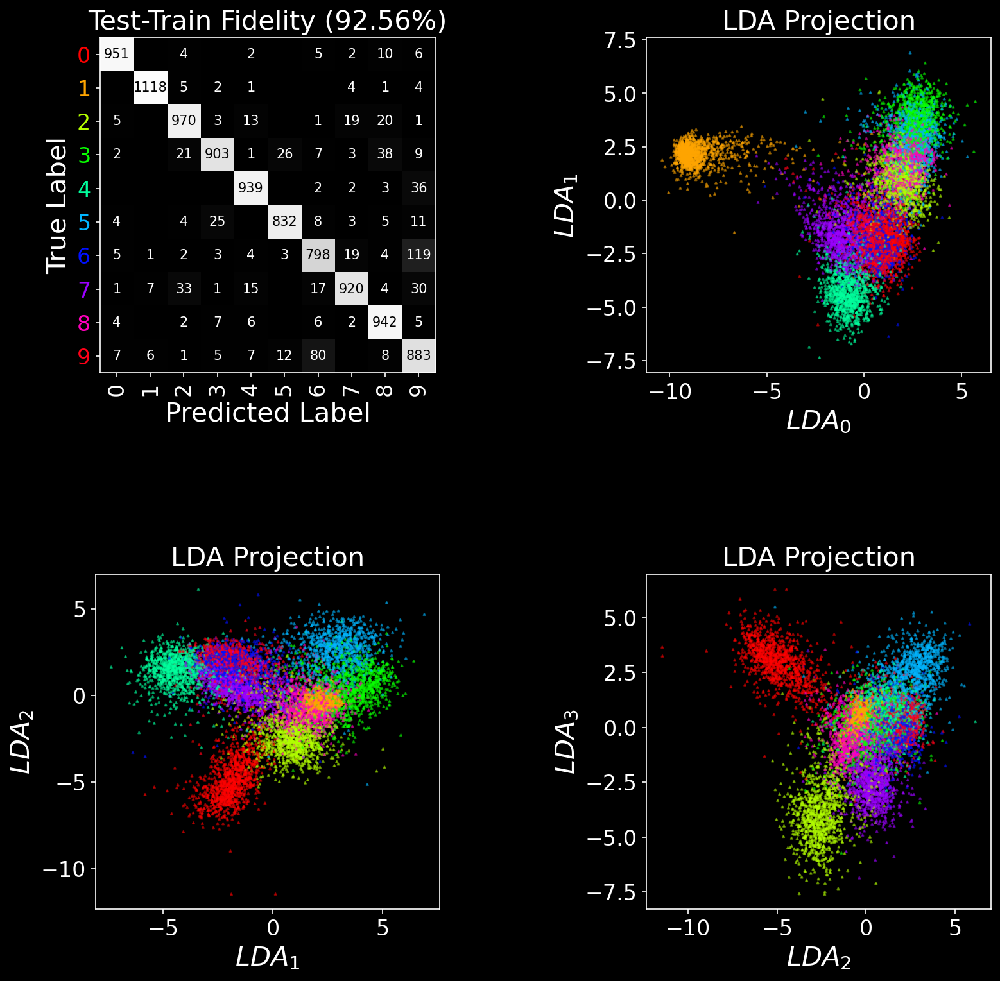

In [94]:
N = 10
labels = [0,1,2,3,4,5,6,7,8,9]
out = LDA_AKS_testman(DHC_dir_vec(mnist_DHC_out_rot7pi,6,8),
                      mnist_train_y,
                      DHC_dir_vec(mnist_DHC_out_rot7pi_test,6,8),
                      mnist_test_y,N-1,labels)

Accuracy0.9614


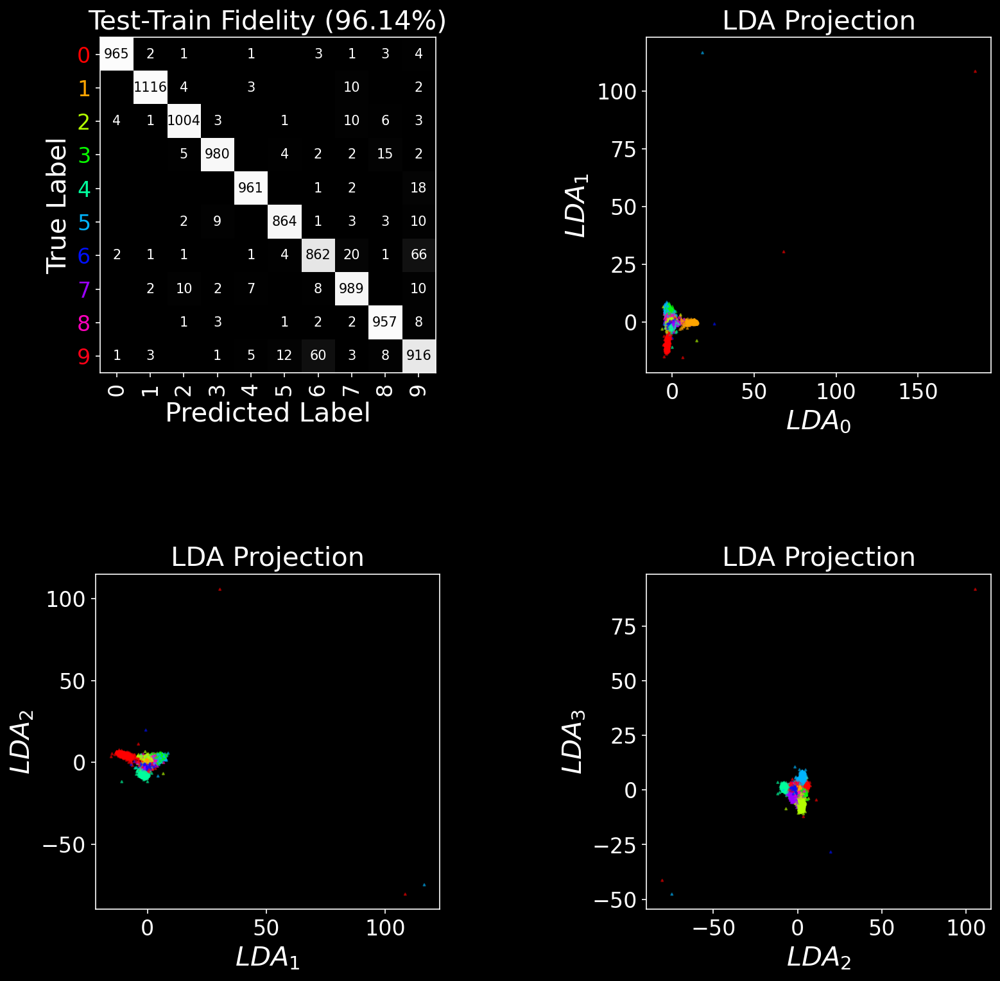

In [95]:
N = 10
labels = [0,1,2,3,4,5,6,7,8,9]
out = LDA_AKS_testman(mnist_DHC_out_rot7pi,
                      mnist_train_y,
                      mnist_DHC_out_rot7pi_test,
                      mnist_test_y,N-1,labels)

Accuracy0.9336


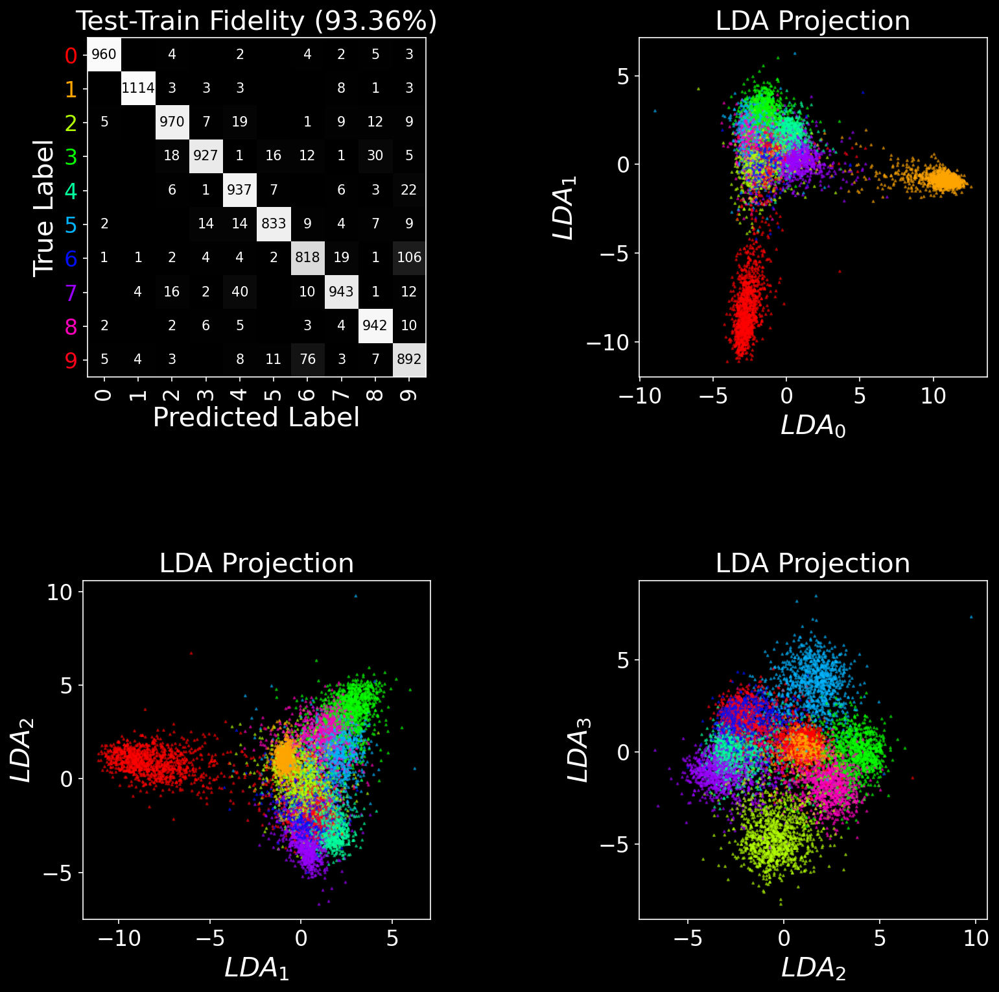

In [96]:
N = 10
labels = [0,1,2,3,4,5,6,7,8,9]
out = LDA_AKS_testman(DHC_iso_vec(mnist_DHC_out_rot7pi,6,8),
                      mnist_train_y,
                      DHC_iso_vec(mnist_DHC_out_rot7pi_test,6,8),
                      mnist_test_y,N-1,labels)

In [101]:
from scipy.io import loadmat
import string

In [99]:
emnist_balanced = loadmat("/Users/saydjari/Dropbox/GradSchool_AKS/Doug/ExtData/EMNIST/emnist-letters.mat")
train_y = np.ravel(emnist_balanced['dataset']['train'][0][0][0][0][1])
test_y = np.ravel(emnist_balanced['dataset']['test'][0][0][0][0][1])
mnist_DHC_out = hd5_open('../scratch_AKS/emnist_letters_train.h5','main/data')
mnist_DHC_out_test = hd5_open('../scratch_AKS/emnist_letters_test.h5','main/data')

Accuracy0.6961057692307693


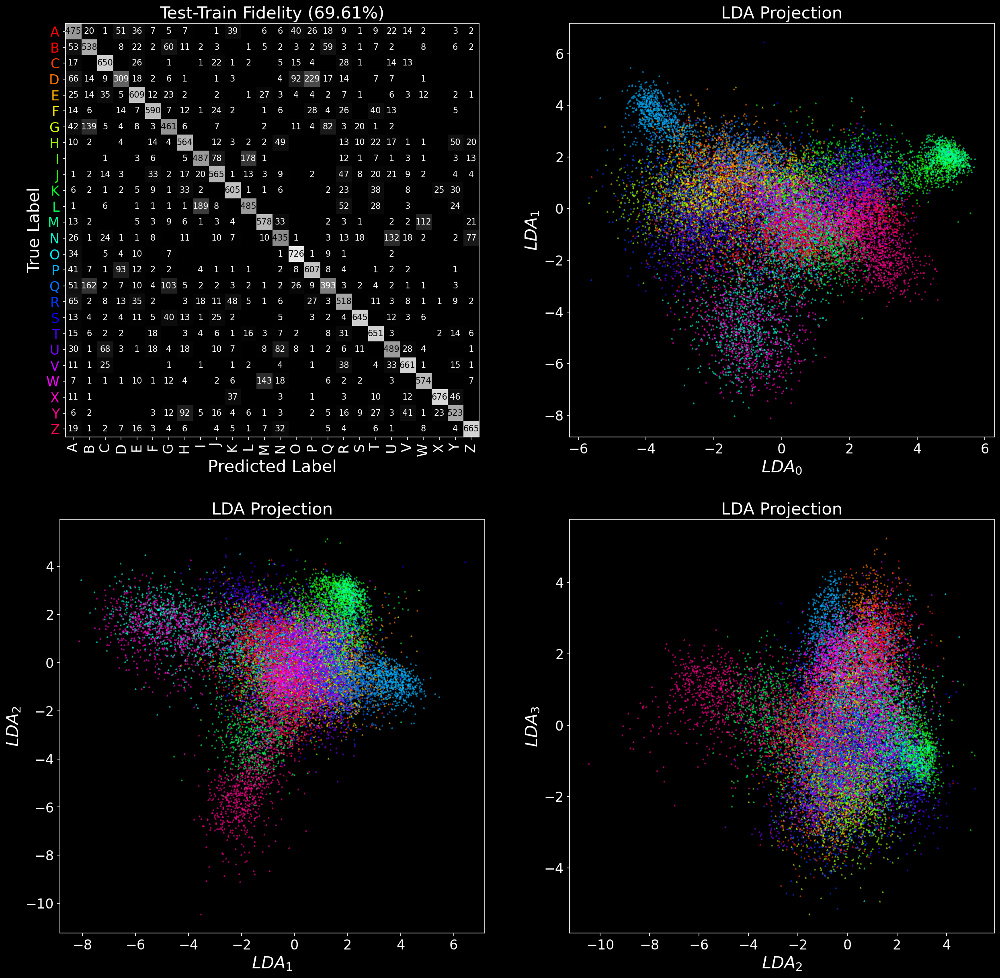

In [105]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(DHC_iso_vec(mnist_DHC_out,5,8),train_y,DHC_iso_vec(mnist_DHC_out_test,5,8),test_y,N-1,labels)

Accuracy0.8359134615384616


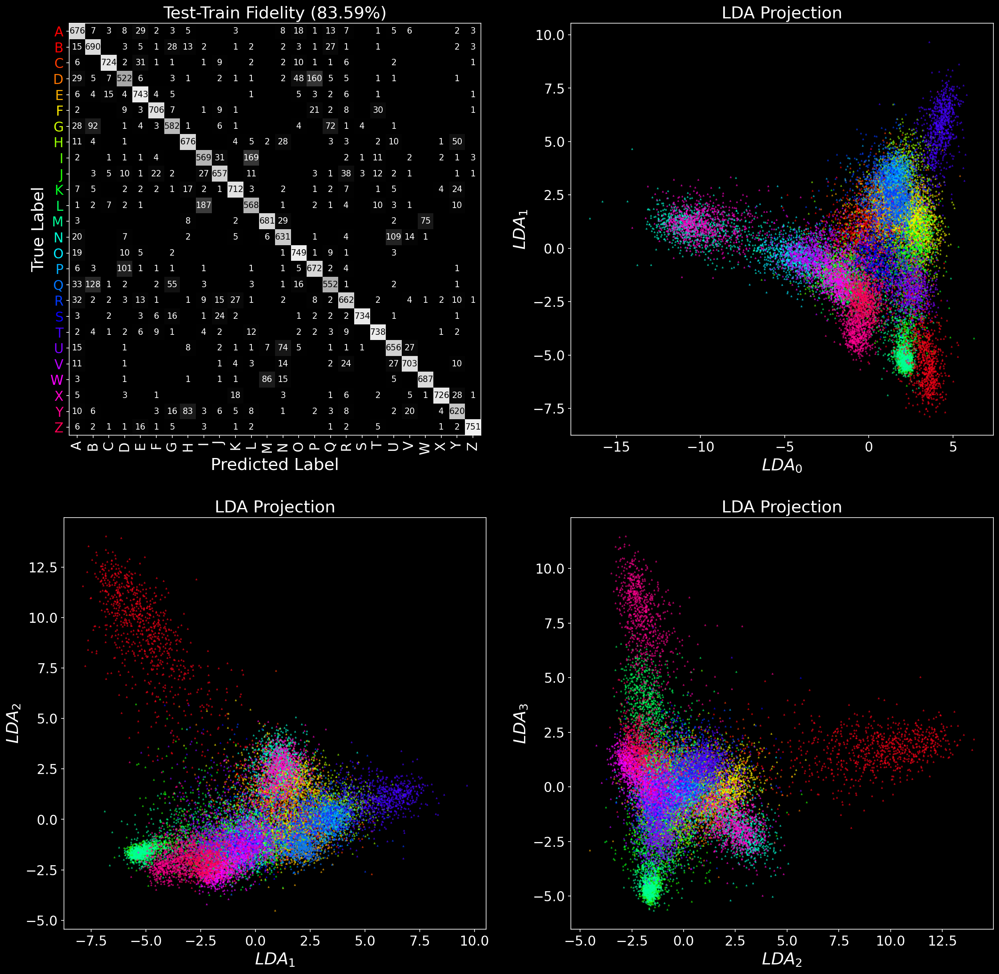

In [106]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(mnist_DHC_out,train_y,mnist_DHC_out_test,test_y,N-1,labels)

Accuracy0.7021153846153846


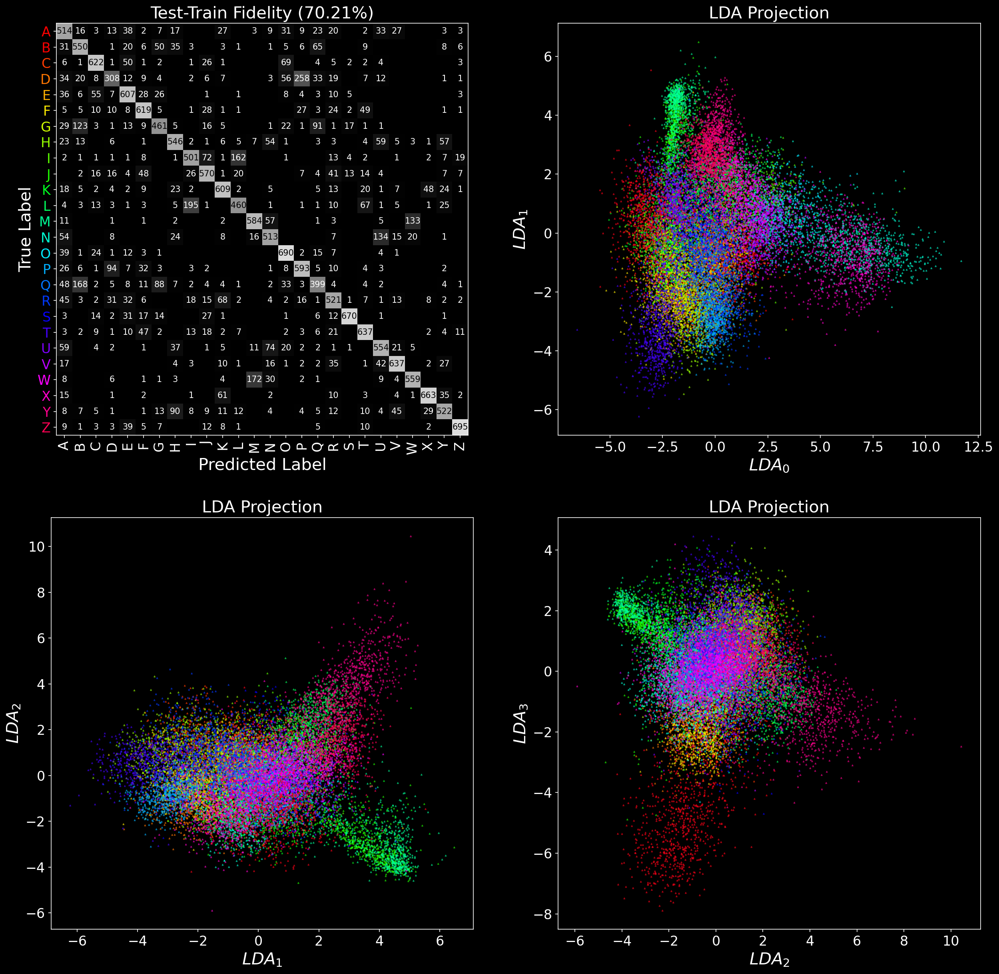

In [107]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(DHC_dir_vec(mnist_DHC_out,5,8),train_y,DHC_dir_vec(mnist_DHC_out_test,5,8),test_y,N-1,labels)

In [164]:
def LDA_AKS_testman(X_train,y_train,X_test,y_test,n_components,label_list):
    lda = LDA(n_components=n_components)
    X_train = lda.fit_transform(X_train, y_train)
    y_pred = lda.predict(X_test)
    X_test = lda.transform(X_test)
    cm = confusion_matrix(y_test, y_pred)
    cm = cm + cm.T
    prec = precision_score(y_test, y_pred,average='micro')
    print('Accuracy' + str(prec))
    cmap_normal = (cm.T/cm.sum(axis=1)).T
    
    ## Good plots
    vmin=y_train.min()
    vmax=y_train.max()
    label_nums = np.unique(y_train)
    marker_size = 10

    from matplotlib import cm as cmplt
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    rgba_colors = [cmplt.hsv(norm(label_nums[indx])) for indx, i in enumerate(label_list)]
    color_order = ["black", "white"]
    color_map = "gray"
    colormap='hsv'
    
    fig = plt.figure(figsize=(20,20),dpi=150)

    ax = fig.add_subplot(2,2,1)    
    ax.imshow(cmap_normal,
          interpolation='nearest',
          cmap=color_map,
          aspect='equal',
          vmin=0,vmax=1)

    ax.set_xticks(np.arange(cm.shape[0]))
    ax.set_yticks(np.arange(cm.shape[1]))
    
    for ytick, color in zip(ax.get_yticklabels(), rgba_colors):
        ytick.set_color(color)

    ax.set_xticklabels(label_list)
    ax.set_yticklabels(label_list)

    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    plt.setp(ax.get_xticklabels(), rotation=90, ha="right",va='center',
             rotation_mode="anchor")
    plt.title('Test-Train Fidelity ({:.2f}%)'.format(100*prec))

    # Loop over data dimensions and create text annotations.
    textcolors=color_order
    threshold = 0.5
    for i in range(cm.shape[0]):
        for j in range(i, cm.shape[1]):
            if cm[i, j] != 0:
                text = ax.text(j, i, cm[i, j],
                               ha="center", va="center", 
                               color=textcolors[int(cmap_normal[i, j] < threshold)])
    if n_components == 1:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train, y_train, s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        #ax.scatter(X_test, y_test, s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
        sns.distplot(X_test[y_test==0],ax=ax)
        sns.distplot(X_test[y_test==1],ax=ax)
        plt.xlabel('$LDA_{}$'.format(0))
        plt.ylabel('Probability Density')
        plt.title('LDA Projection')
        
    if n_components == 2:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train[:,0], X_train[:,1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        ax.scatter(X_test[:,0], X_test[:,1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
        plt.xlabel('$LDA_{}$'.format(i-2))
        plt.ylabel('$LDA_{}$'.format(i-1))
        plt.title('LDA Projection')
    elif n_components > 2:
        for i in range(2,5):
            ax = fig.add_subplot(2,2,i)
            #ax.scatter(X_train[:,i-2], X_train[:,i-1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
            ax.scatter(X_test[:,i-2], X_test[:,i-1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
            plt.xlabel('$LDA_{}$'.format(i-2))
            plt.ylabel('$LDA_{}$'.format(i-1))
            plt.title('LDA Projection')

    fig.subplots_adjust(wspace=0.2, hspace=0.2)
    plt.show()
    
    return (lda,cm,X_train,X_test,y_train,y_test,y_pred)

Accuracy0.6961057692307693


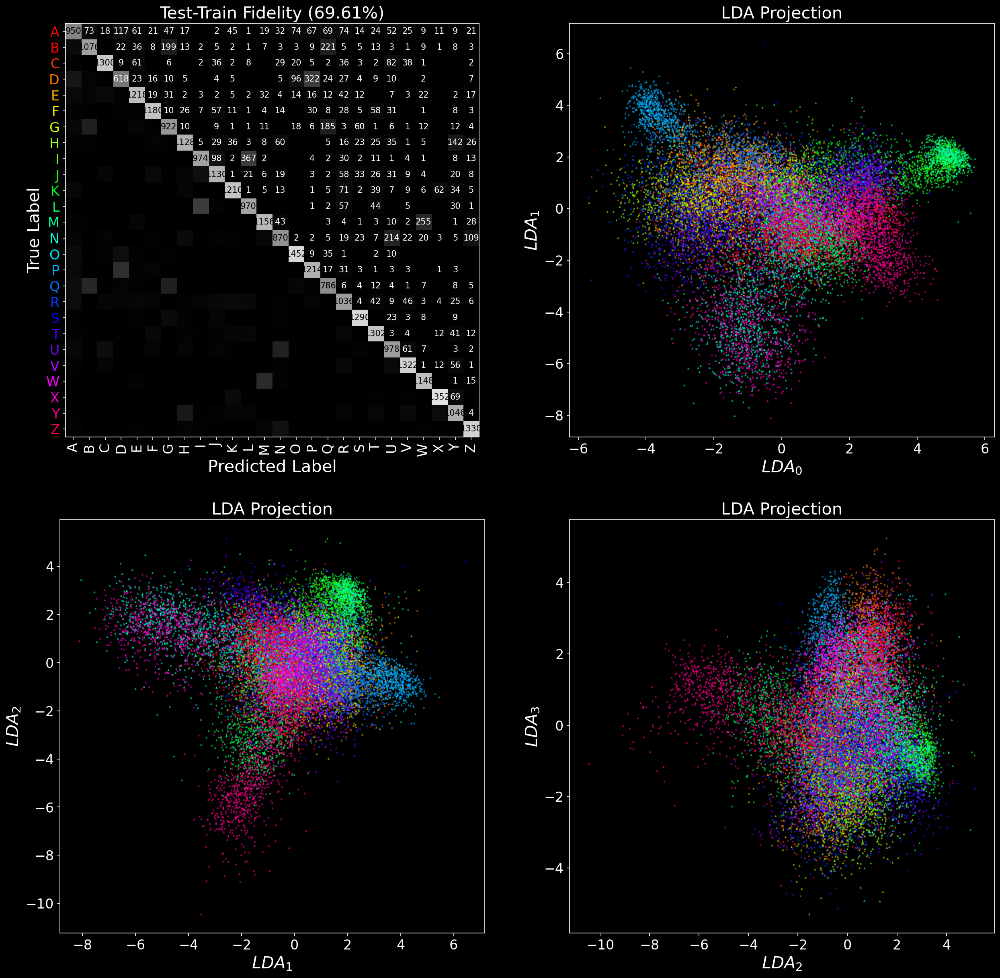

In [121]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(DHC_iso_vec(mnist_DHC_out,5,8),train_y,DHC_iso_vec(mnist_DHC_out_test,5,8),test_y,N-1,labels)

Accuracy0.8359134615384616


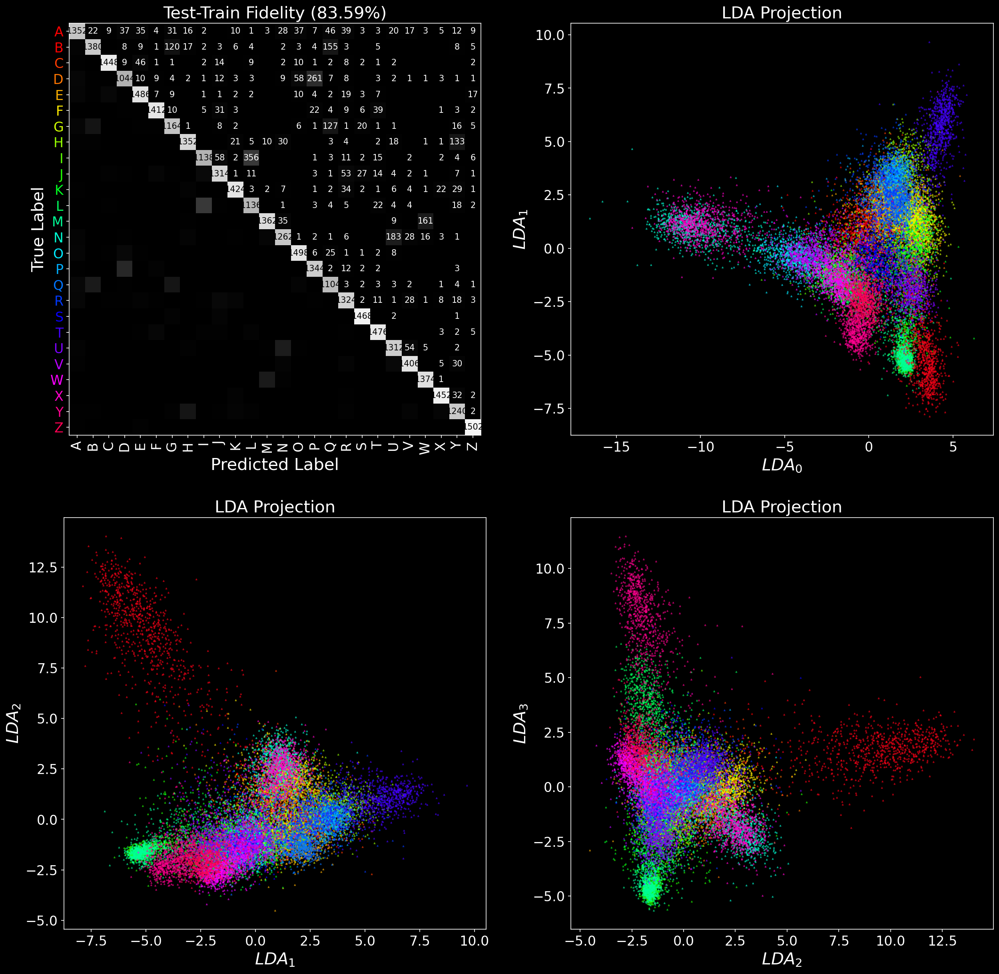

In [123]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(mnist_DHC_out,train_y,mnist_DHC_out_test,test_y,N-1,labels)

Accuracy0.7021153846153846


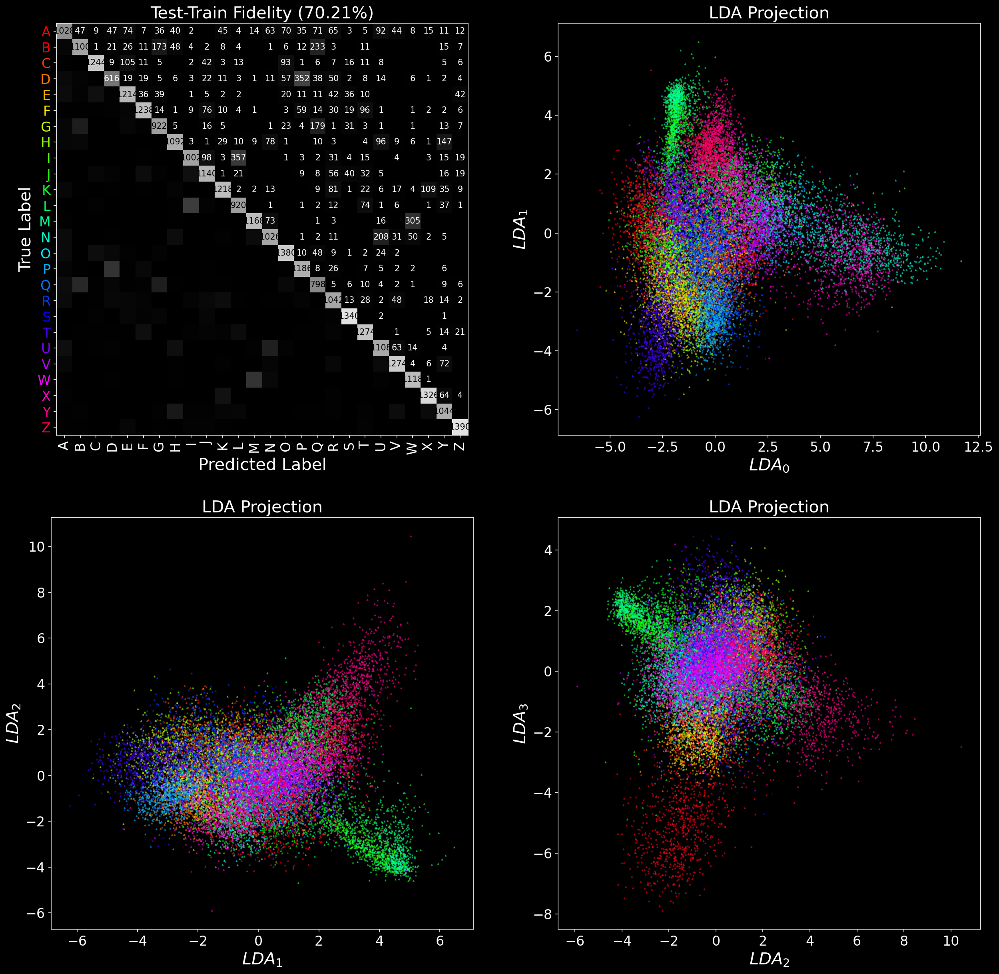

In [124]:
N = 26
labels = list(string.ascii_uppercase)
out = LDA_AKS_testman(DHC_dir_vec(mnist_DHC_out,5,8),train_y,DHC_dir_vec(mnist_DHC_out_test,5,8),test_y,N-1,labels)

In [157]:
train_y_red = train_y[np.any([train_y==8,train_y==9,train_y==19,train_y==26,train_y==18,train_y==23],axis=0)]
test_y_red = test_y[np.any([test_y==8,test_y==9,test_y==19,test_y==26,test_y==18,test_y==23],axis=0)]
mnist_DHC_out_red = mnist_DHC_out[np.any([train_y==8,train_y==9,train_y==19,train_y==26,train_y==18,train_y==23],axis=0)]
mnist_DHC_out_test_red = mnist_DHC_out_test[np.any([test_y==8,test_y==9,test_y==19,test_y==26,test_y==18,test_y==23],axis=0)]

mnist_DHC_out_red = np.squeeze(mnist_DHC_out_red)
mnist_DHC_out_test_red = np.squeeze(mnist_DHC_out_test_red)
train_y_red = np.squeeze(train_y_red)
test_y_red = np.squeeze(test_y_red)

In [172]:
def LDA_AKS_testman(X_train,y_train,X_test,y_test,n_components,label_list):
    lda = LDA(n_components=n_components)
    X_train = lda.fit_transform(X_train, y_train)
    y_pred = lda.predict(X_test)
    X_test = lda.transform(X_test)
    cm = confusion_matrix(y_test, y_pred)
    cm = cm + cm.T
    prec = precision_score(y_test, y_pred,average='micro')
    print('Accuracy' + str(prec))
    cmap_normal = (cm.T/cm.sum(axis=1)).T
    
    ## Good plots
    vmin=y_train.min()
    vmax=y_train.max()
    label_nums = np.unique(y_train)
    marker_size = 10

    from matplotlib import cm as cmplt
    norm = mpl.colors.Normalize(vmin=vmin, vmax=vmax)
    rgba_colors = [cmplt.hsv(norm(label_nums[indx])) for indx, i in enumerate(label_list)]
    color_order = ["black", "white"]
    color_map = "gray"
    colormap='hsv'
    
    fig = plt.figure(figsize=(12,12),dpi=150)

    ax = fig.add_subplot(2,2,1)    
    ax.imshow(cmap_normal,
          interpolation='nearest',
          cmap=color_map,
          aspect='equal',
          vmin=0,vmax=1)

    ax.set_xticks(np.arange(cm.shape[0]))
    ax.set_yticks(np.arange(cm.shape[1]))
    
    for ytick, color in zip(ax.get_yticklabels(), rgba_colors):
        ytick.set_color(color)

    ax.set_xticklabels(label_list)
    ax.set_yticklabels(label_list)

    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    plt.setp(ax.get_xticklabels(), rotation=90, ha="right",va='center',
             rotation_mode="anchor")
    plt.title('Test-Train Fidelity ({:.2f}%)'.format(100*prec))

    # Loop over data dimensions and create text annotations.
    textcolors=color_order
    threshold = 0.5
    for i in range(cm.shape[0]):
        for j in range(i, cm.shape[1]):
            if cm[i, j] != 0:
                text = ax.text(j, i, cm[i, j],
                               ha="center", va="center", 
                               color=textcolors[int(cmap_normal[i, j] < threshold)])
    if n_components == 1:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train, y_train, s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        #ax.scatter(X_test, y_test, s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
        sns.distplot(X_test[y_test==0],ax=ax)
        sns.distplot(X_test[y_test==1],ax=ax)
        plt.xlabel('$LDA_{}$'.format(0))
        plt.ylabel('Probability Density')
        plt.title('LDA Projection')
        
    if n_components == 2:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train[:,0], X_train[:,1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        ax.scatter(X_test[:,0], X_test[:,1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
        plt.xlabel('$LDA_{}$'.format(i-2))
        plt.ylabel('$LDA_{}$'.format(i-1))
        plt.title('LDA Projection')
    elif n_components > 2:
        for i in range(2,5):
            ax = fig.add_subplot(2,2,i)
            #ax.scatter(X_train[:,i-2], X_train[:,i-1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
            ax.scatter(X_test[:,i-2], X_test[:,i-1], s=2, marker='^', zorder=10,c=y_test, cmap = colormap, vmin=vmin, vmax=vmax,alpha=0.5)
            plt.xlabel('$LDA_{}$'.format(i-2))
            plt.ylabel('$LDA_{}$'.format(i-1))
            plt.title('LDA Projection')

    fig.subplots_adjust(wspace=0.4, hspace=0.4)
    plt.show()
    
    return (lda,cm,X_train,X_test,y_train,y_test,y_pred)

Accuracy0.9360416666666667


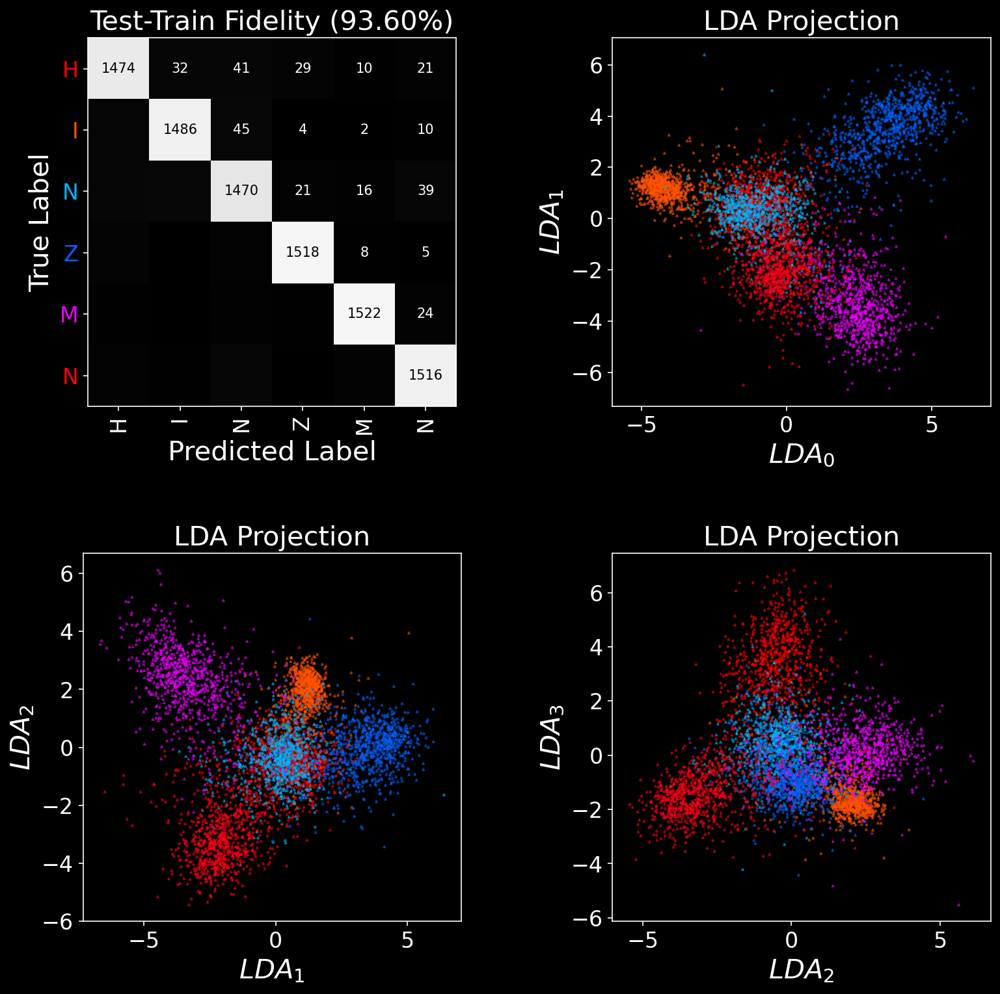

In [173]:
N = 6
labels = ['H','I','N','Z','M','N']
out = LDA_AKS_testman(DHC_iso_vec(mnist_DHC_out_red,5,8),train_y_red,DHC_iso_vec(mnist_DHC_out_test_red,5,8),test_y_red,N-1,labels)

Accuracy0.9854166666666667


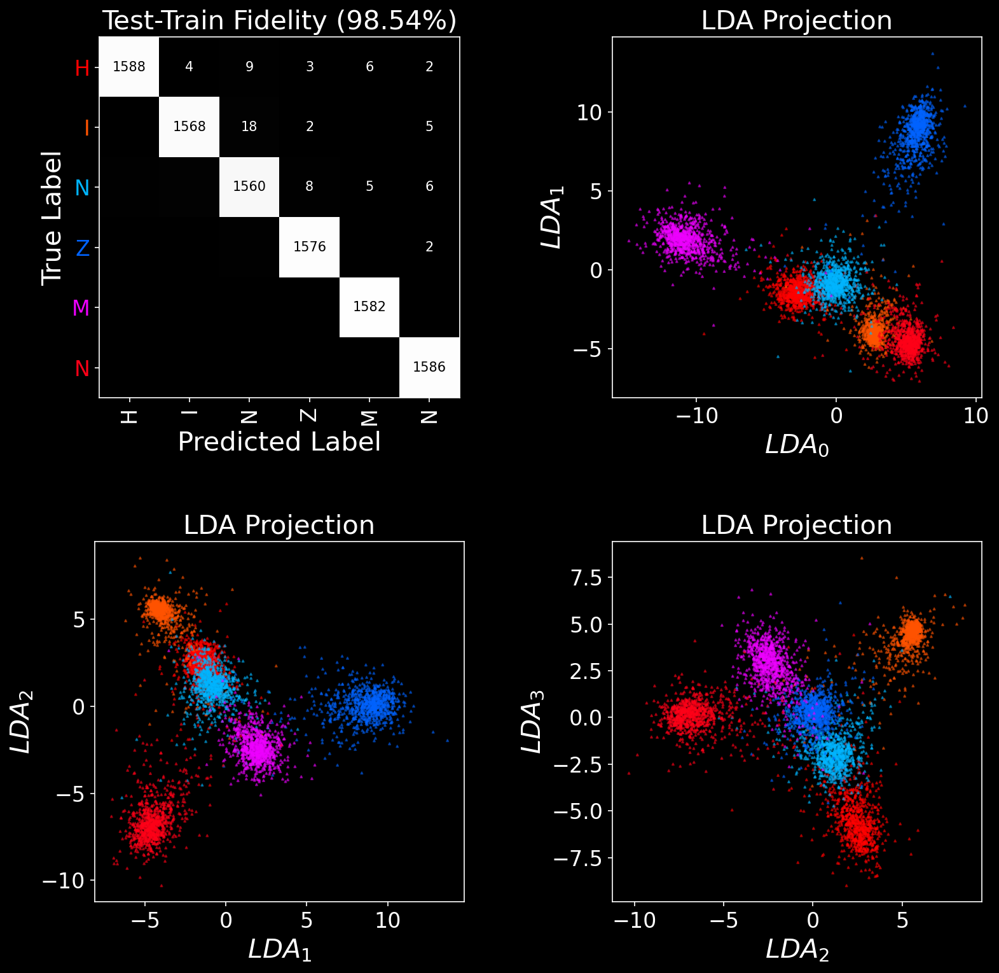

In [174]:
N = 6
labels = ['H','I','N','Z','M','N']
out = LDA_AKS_testman(mnist_DHC_out_red,train_y_red,mnist_DHC_out_test_red,test_y_red,N-1,labels)

Accuracy0.9485416666666666


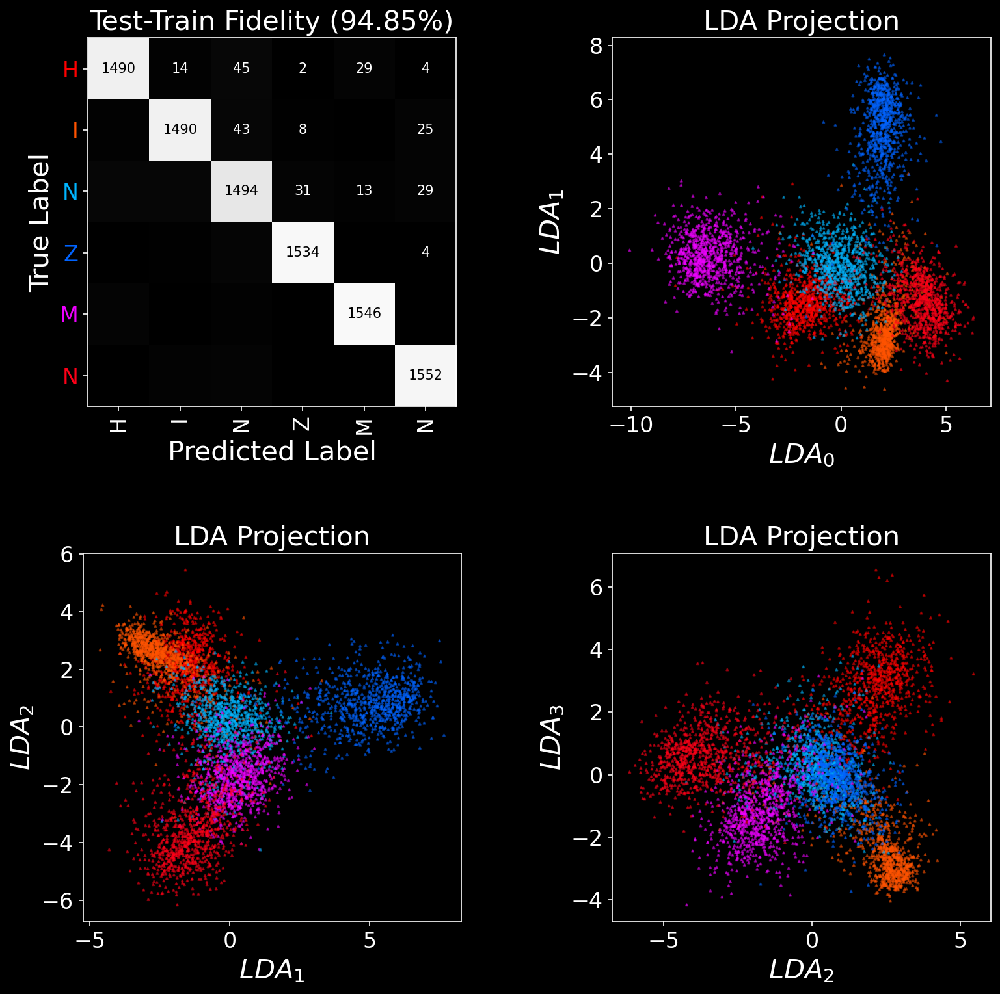

In [175]:
N = 6
labels = ['H','I','N','Z','M','N']
out = LDA_AKS_testman(DHC_dir_vec(mnist_DHC_out_red,5,8),train_y_red,DHC_dir_vec(mnist_DHC_out_test_red,5,8),test_y_red,N-1,labels)

In [177]:
DHC_dir_vec(mnist_DHC_out_red,5,8).shape,DHC_iso_vec(mnist_DHC_out_red,5,8).shape,mnist_DHC_out_red.shape

((28800, 134), (28800, 219), (28800, 1724))